<table style="font-size: 1em; padding: 0; margin: 0;">

<tr style="vertical-align: top; padding: 0; margin: 0;background-color: #ffffff">
        <td style="vertical-align: top; padding: 0; margin: 0; padding-right: 15px;">
    <p style="background: #182AEB; color:#ffffff; text-align:justify; padding: 10px 25px;">
        <strong style="font-size: 1.0em;"><span style="font-size: 1.2em;"><span style="color: #ffffff;">Deep Learning </span> for Satellite Image Classification (Manning Publications)</span><br/>by <em>Daniel Buscombe</em></strong><br/><br/>
        <strong>> Chapter 4: Model Training and Evaluation </strong><br/>
    </p>           
        
<p style="border: 1px solid #182AEB; border-left: 15px solid #182AEB; padding: 10px; text-align:justify;">
    <strong style="color: #182AEB">What you learned in Part 3.</strong>  
    <br/>In Part 3, you learned how to set up and merge image generators, carry out data augmentation, put together and train deep learning models for denoising imagery using keras/Tensorflow 2, and put together a trainable UNet model implementation for semantic segmentation.
    </p>
    
<p style="border: 1px solid #ff5733; border-left: 15px solid #ff5733; padding: 10px; text-align:justify;">
    <strong style="color: #ff5733">What you will learn in this Part.</strong>  
    <br/>In Part 4, you will first learn a few core concepts in training deep learning models, create checkpoints and callback functions for training your UNet model, and then train that model on a non-augmented and augmented Sentinel2-cloudless dataset. Finally, you will plot the training histories of the model training and validation, and use the model on a test image for prediction.
    </p>    

Switch to (or install) tensorflow 2 (if you are on colab)

In [1]:
#colab = 0
colab = 1

if colab==1:
    %tensorflow_version 2.x
    !pip install --default-timeout=1000 tensorflow-gpu==2.0   

You may have to restart the runtime and/or change runtime type here, if the following doesn't show Tensorflow version 2, and a GPU available

In [2]:
import tensorflow as tf
tf.__version__

'2.0.0'

In [3]:
tf.test.is_gpu_available()

True

<table style="font-size: 1em; padding: 0; margin: 0;">

<h1 style="width: 100%; text-align: left; padding: 0px 25px;"><small style="color: #182AEB;">
    </small><br/>Key concepts in  <br/> training deep learning models</h1>
<br/>
<p style="border-left: 15px solid #182AEB; text-align:justify; padding: 0 10px;">
A a high level, model training consists of, upon each successive iteration:

* Evaluate the current model but computing its _loss_, which is the mismatch between the a batch of validation labels and the model's current estimate of those labels

* Adjust the weights of the network (the parameters of the model) to try to reduce the loss

* Repeat the above until the model solution converges (it cannot be improved)
</p>
        </tr>
        </table>

### Backpropagation
Backpropagation is a method to update the weights in the neural network by taking into account the actual output and the desired output. 

### Updating weights
In a neural network, weights are updated as follows:

* Step 1: Take a batch of training data and perform forward propagation to compute the loss. 
* Step 2: Backpropagate the loss to get the gradient of the loss with respect to each weight. 
* Step 3: Use the gradients to update the weights of the network.

![](https://stanford.edu/~shervine/images/update-weights.png)
[source](https://stanford.edu/~shervine/teaching/cs-230/cheatsheet-deep-learning-tips-and-tricks)

### Optimizing convergence

Stochastic Gradient Descent is a popular way to find how to minimize a cost function  (called finding a global minima)

For each example in the data:

* find the value predicted by the neural network 
* calculate the loss from the loss function 
* find partial derivatives of the loss function, these partial derivatives produce gradients
* use the gradients to update the values of weights and biases

A more detailed yet accessible explanation may be found [here](http://ruder.io/optimizing-gradient-descent/) 

#### Learning rate
The learning rate, indicates at which pace the weights get updated. It can be fixed or adaptively changed. 

* If the learning rate is low, then training is more reliable, but optimization will take a lot of time because steps towards the minimum of the loss function are tiny.

* If the learning rate is high, then training may not converge or even diverge. Weight changes can be so big that the optimizer overshoots the minimum and makes the loss worse.

![](https://cdn-images-1.medium.com/max/1000/0*QwE8M4MupSdqA3M4.png)

[source](https://towardsdatascience.com/a-look-at-gradient-descent-and-rmsprop-optimizers-f77d483ef08b)


#### Adaptive learning rates
Letting the learning rate vary when training a model can reduce the training time and improve the numerical optimal solution. 

* The Adam optimizer is the most commonly used technique. 

* Here we are using a technique called Root Mean Squared Propagation" or RMSprop an adaptive version of Stochastic Gradient Descent. A more detailed yet accessible explanation may be found [here](http://ruder.io/optimizing-gradient-descent/) 


#### Loss function

Binary cross-entropy compares the log of probabilities of each predicted class with the log of the observed values.  

### Semantic segmentation of water using U-Net

In [4]:
# from https://stackoverflow.com/questions/38511444/python-download-files-from-google-drive-using-url
import requests

def download_file_from_google_drive(id, destination):
    URL = "https://docs.google.com/uc?export=download"

    session = requests.Session()

    response = session.get(URL, params = { 'id' : id }, stream = True)
    token = get_confirm_token(response)

    if token:
        params = { 'id' : id, 'confirm' : token }
        response = session.get(URL, params = params, stream = True)

    save_response_content(response, destination)    

def get_confirm_token(response):
    for key, value in response.cookies.items():
        if key.startswith('download_warning'):
            return value

    return None

def save_response_content(response, destination):
    CHUNK_SIZE = 32768

    with open(destination, "wb") as f:
        for chunk in response.iter_content(CHUNK_SIZE):
            if chunk: # filter out keep-alive new chunks
                f.write(chunk)

In [5]:
#imagery
file_id = '1iMfIjr_ul49Ghs2ewazjCt8HMPfhY47h'
destination = 's2cloudless_imagery.zip'
if colab==1:
    download_file_from_google_drive(file_id, destination)
    
#labels
file_id = '1c7MpwKVejoUuW9F2UaF_vps8Vq2RZRfR'
destination = 's2cloudless_label_imagery.zip'
if colab==1:
    download_file_from_google_drive(file_id, destination)    

In [6]:
import zipfile
def unzip(f):
    """
    f = file to be unzipped
    """    
    with zipfile.ZipFile(f, 'r') as zip_ref:
        zip_ref.extractall()
        
if colab==1:
    unzip('s2cloudless_imagery.zip')
    unzip('s2cloudless_label_imagery.zip')        

#### Training a Unet to detect water in Sentinel2-cloudless imagery

Import the libraries we will need:

In [7]:
%matplotlib inline
import tensorflow as tf
from tensorflow.keras.layers import Input, Conv2D, MaxPooling2D, UpSampling2D
from tensorflow.keras.layers import Concatenate, Conv2DTranspose
from tensorflow.keras.models import Model
import numpy as np
import json, os
from random import shuffle
from PIL import Image
import matplotlib
import matplotlib.pyplot as plt

Use the same IOU and Unet functions we used in the last Part

In [8]:
def mean_iou(y_true, y_pred):
    yt0 = y_true[:,:,:,0]
    yp0 = tf.keras.backend.cast(y_pred[:,:,:,0] > 0.5, 'float32')
    inter = tf.math.count_nonzero(tf.logical_and(tf.equal(yt0, 1), tf.equal(yp0, 1)))
    union = tf.math.count_nonzero(tf.add(yt0, yp0))
    iou = tf.where(tf.equal(union, 0), 1., tf.cast(inter/union, 'float32'))
    return iou

In [9]:
def unet(sz = (512, 512, 3)):
  inputs = Input(sz)
  _ = inputs
  
  #down sampling 
  f = 8
  layers = []
  
  for i in range(0, 6):
    _ = Conv2D(f, 3, activation='relu', padding='same') (_)
    _ = Conv2D(f, 3, activation='relu', padding='same') (_)
    layers.append(_)
    _ = MaxPooling2D() (_)
    f = f*2
  ff2 = 64 
  
  #bottleneck 
  j = len(layers) - 1
  _ = Conv2D(f, 3, activation='relu', padding='same') (_)
  _ = Conv2D(f, 3, activation='relu', padding='same') (_)
  _ = Conv2DTranspose(ff2, 2, strides=(2, 2), padding='same') (_)
  _ = Concatenate(axis=3)([_, layers[j]])
  j = j -1 
  
  #upsampling 
  for i in range(0, 5):
    ff2 = ff2//2
    f = f // 2 
    _ = Conv2D(f, 3, activation='relu', padding='same') (_)
    _ = Conv2D(f, 3, activation='relu', padding='same') (_)
    _ = Conv2DTranspose(ff2, 2, strides=(2, 2), padding='same') (_)
    _ = Concatenate(axis=3)([_, layers[j]])
    j = j -1 
    
  #classification 
  _ = Conv2D(f, 3, activation='relu', padding='same') (_)
  _ = Conv2D(f, 3, activation='relu', padding='same') (_)
  outputs = Conv2D(1, 1, activation='sigmoid') (_)
  
  #model creation 
  model = Model(inputs=[inputs], outputs=[outputs])
  model.compile(optimizer = 'rmsprop', loss = 'binary_crossentropy', metrics = [mean_iou])
  
  return model  

In [10]:
model = unet()
model.summary()

Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 512, 512, 3) 0                                            
__________________________________________________________________________________________________
conv2d (Conv2D)                 (None, 512, 512, 8)  224         input_1[0][0]                    
__________________________________________________________________________________________________
conv2d_1 (Conv2D)               (None, 512, 512, 8)  584         conv2d[0][0]                     
__________________________________________________________________________________________________
max_pooling2d (MaxPooling2D)    (None, 256, 256, 8)  0           conv2d_1[0][0]                   
______________________________________________________________________________________________

#### Checkpoints

Checkpoints are a way to save the current state of your model so that you can pick up from where you left off. They capture

* The architecture of the model, allowing you to re-create the model

* The weights of the model (for now, these will essentially be random numbers)

* The training configuration (loss, optimizer, epochs, and other meta-information - I'll explain what all this means later)

With Colab, GPU kernels may terminate, suddenly and without warning. Therefore, it is often a good idea to keep number of training epochs small, but to use checkpoints

Then, it looks from images and corresponding label images, and trains a deep learning model **end-to-end**. This means that all the parameters in the models will be learned from our data, using a single large network that automatically learns how to map inputs (pixels and regions of images) to outputs (our classes). This is computationally intensive, hence the need for GPUs. Our workflow would therefore be described in the DL literature as 'end-to-end'. 

We will are not using 'transfer learning', which is the (usually less computationally intensive) process of using not only existing models, but also re-purposing existing parameters sets learned from other data.

Functions to save the model at each epoch and show some predictions 

In [11]:
# inheritance for training process plot 
class PlotLearning(tf.keras.callbacks.Callback):

    def on_train_begin(self, logs={}):
        self.i = 0
        self.x = []
        self.losses = []
        self.val_losses = []
        self.acc = []
        self.val_acc = []
        #self.fig = plt.figure()
        self.logs = []
    def on_epoch_end(self, epoch, logs={}):
        self.logs.append(logs)
        self.x.append(self.i)
        self.losses.append(logs.get('loss'))
        self.val_losses.append(logs.get('val_loss'))
        self.acc.append(logs.get('mean_iou'))
        self.val_acc.append(logs.get('val_mean_iou'))
        self.i += 1
        print('i=',self.i,'loss=',logs.get('loss'),'val_loss=',logs.get('val_loss'),'mean_iou=',logs.get('mean_iou'),'val_mean_iou=',logs.get('val_mean_iou'))
        
        #choose a random test image and preprocess
        path = np.random.choice(test_files)
        infile = f's2cloudless_imagery/data/{path}'
        raw = Image.open(infile)
        raw = np.array(raw.resize((512, 512)))/255.
        raw = raw[:,:,0:3]
        
        #predict the mask 
        pred = 255*model.predict(np.expand_dims(raw, 0)).squeeze()
        print(np.max(pred))
                
        #mask post-processing 
        msk  = (pred>60).astype('int') #100       
        msk = np.stack((msk,)*3, axis=-1)
        #msk[msk >= 0.5] = 1 
        #msk[msk < 0.5] = 0 
        
        #show the mask and the segmented image 
        combined = np.concatenate([raw, msk, raw* msk], axis = 1)
        plt.axis('off')
        plt.imshow(combined)
        plt.show()

In [12]:
def build_callbacks():
        checkpointer = tf.keras.callbacks.ModelCheckpoint(filepath='unet.h5', verbose=0, save_best_only=True, save_weights_only=True)
        callbacks = [checkpointer, PlotLearning()]
        return callbacks

Colab users, you will need to quickly upload your copy of ```all_labels.json``` here. The json file contains the image names

In [13]:
if colab == 1:
  file_id = '1Zz7scOC5rc8VmO1_vx7BzCJP0BjHH9mX'
  destination = 'all_labels.json'
  download_file_from_google_drive(file_id, destination)
  #with open("all_labels.json","rt") as myf:
  #  data = myf.read()
  #  print(data)
  #data = json.load(open("all_labels.json","rt"))

In [14]:
# load the labels than contain the image list
data = json.load(open('all_labels.json'))
images = sorted(data.keys())

Use the image batch generator that we used in the previous Part

In [15]:
def image_batch_generator(files, batch_size = 32, sz = (512, 512)):
  
  while True: # this is here because it will be called repeatedly by the training function
    
    #extract a random subset of files of length "batch_size"
    batch = np.random.choice(files, size = batch_size)    
    
    #variables for collecting batches of inputs (x) and outputs (y)
    batch_x = []
    batch_y = []
    
    #cycle through each image in the batch
    for f in batch:

        #preprocess the raw images 
        rawfile = f's2cloudless_imagery/data/{f}'
        raw = Image.open(rawfile)
        raw = raw.resize(sz)
        raw = np.array(raw)

        #check the number of channels because some of the images are RGBA or GRAY
        if len(raw.shape) == 2:
            raw = np.stack((raw,)*3, axis=-1)

        else:
            raw = raw[:,:,0:3]
            
        #get the image dimensions, find the min dimension, then square the image off    
        nx, ny, nz = np.shape(raw)
        n = np.minimum(nx,ny)
        raw = raw[:n,:n,:] 
            
        batch_x.append(raw)
        
        #get the masks. 
        maskfile = rawfile.replace('s2cloudless_imagery','s2cloudless_label_imagery')+'_mask.jpg'
        mask = Image.open(maskfile)
        # the mask is 3-dimensional so get the max in each channel to flatten to 2D
        mask = np.max(np.array(mask.resize(sz)),axis=2)
        # water pixels are always greater than 100
        mask = (mask>100).astype('int')
        
        mask = mask[:n,:n]

        batch_y.append(mask)

    #preprocess a batch of images and masks 
    batch_x = np.array(batch_x)/255. #divide image by 255 to normalize
    batch_y = np.array(batch_y)
    batch_y = np.expand_dims(batch_y,3) #add singleton dimension to batch_y

    yield (batch_x, batch_y) #yield both the image and the label together

Define our one hyperparameter (batch size), the proportion of the dataset to use for training (60%), then get all the files, shuffle them randomly, draw 60% for training, then use the rest for testing

In [16]:
batch_size = 8

prop_train = 0.6

all_files = os.listdir('s2cloudless_imagery/data')
shuffle(all_files)

split = int(prop_train * len(all_files))

#split into training and testing
train_files = all_files[0:split]
test_files  = all_files[split:]

Based on these files, define train and test generators

In [17]:
train_generator = image_batch_generator(train_files, batch_size = batch_size)
test_generator  = image_batch_generator(test_files, batch_size = batch_size)

We're going to define the number of steps per epoch (based on the batch size) and also the number of epochs

In [18]:
train_steps = len(train_files) //batch_size
test_steps = len(test_files) //batch_size

print(train_steps)
print(test_steps)

3
2


Start model training. Use `verbose = 0` because we have a callback function that displays a test image and prediction at the end of each epoch. We `use_multiprocessing = True` in case keras complains about our image generator function not being thread-safe 

i= 1 loss= 0.6441445748011271 val_loss= 0.5342247486114502 mean_iou= 0.063511364 val_mean_iou= 0.0
123.96998


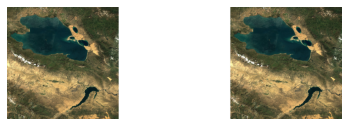

i= 2 loss= 0.4385341803232829 val_loss= 0.36000141501426697 mean_iou= 0.0 val_mean_iou= 0.0
118.3241


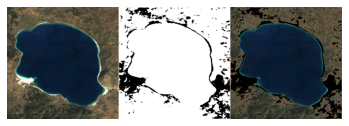

i= 3 loss= 0.3665958046913147 val_loss= 0.29671627283096313 mean_iou= 0.0 val_mean_iou= 0.0067274803
130.68913


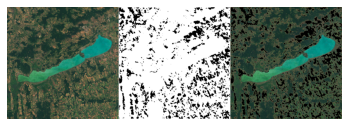

i= 4 loss= 0.30571552117665607 val_loss= 0.25415877997875214 mean_iou= 4.9978553e-05 val_mean_iou= 0.0016261006
118.22279


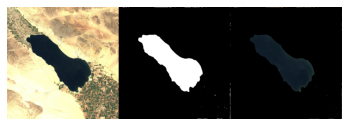

i= 5 loss= 0.28112758199373883 val_loss= 0.2438163235783577 mean_iou= 0.13500631 val_mean_iou= 0.7828974
134.02954


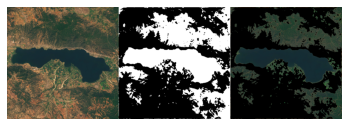

i= 6 loss= 0.283846249183019 val_loss= 0.20512724667787552 mean_iou= 0.51901734 val_mean_iou= 0.4325128
133.7194


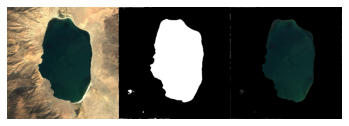

i= 7 loss= 0.2258342703183492 val_loss= 0.228036567568779 mean_iou= 0.41871074 val_mean_iou= 0.73812103
87.278946


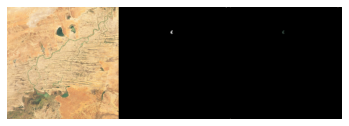

i= 8 loss= 0.2315813551346461 val_loss= 0.23495861142873764 mean_iou= 0.6991455 val_mean_iou= 0.5850475
169.03885


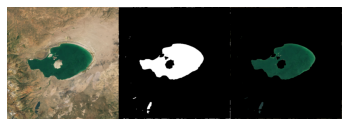

i= 9 loss= 0.19480348626772562 val_loss= 0.32924969494342804 mean_iou= 0.6118632 val_mean_iou= 0.38972408
186.8978


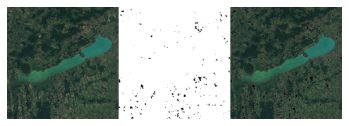

i= 10 loss= 0.19669117530186972 val_loss= 0.1962359920144081 mean_iou= 0.8024411 val_mean_iou= 0.7855686
201.97554


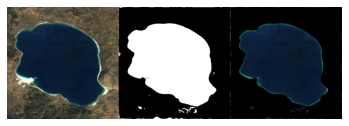

i= 11 loss= 0.21764634549617767 val_loss= 0.697135403752327 mean_iou= 0.7499328 val_mean_iou= 0.32717592
245.19084


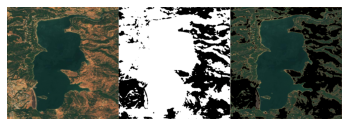

i= 12 loss= 0.277984619140625 val_loss= 0.30188335478305817 mean_iou= 0.51278377 val_mean_iou= 0.39704517
173.05605


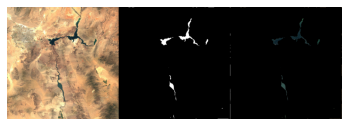

i= 13 loss= 1.9094653278589249 val_loss= 0.33453767001628876 mean_iou= 0.6451265 val_mean_iou= 0.357547
166.99277


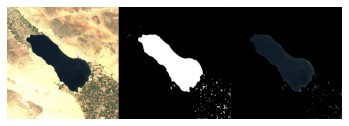

i= 14 loss= 0.21985681851704916 val_loss= 0.34606485068798065 mean_iou= 0.5078688 val_mean_iou= 0.34585625
209.70285


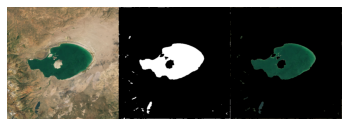

i= 15 loss= 0.1564122885465622 val_loss= 0.373849019408226 mean_iou= 0.7943179 val_mean_iou= 0.30807483
236.09901


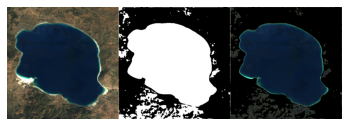

i= 16 loss= 0.22107519706090292 val_loss= 0.29318659007549286 mean_iou= 0.6623948 val_mean_iou= 0.31753305
206.43414


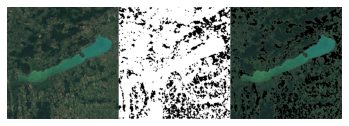

i= 17 loss= 0.20612329741319022 val_loss= 0.2586338669061661 mean_iou= 0.8851724 val_mean_iou= 0.335529
75.70526


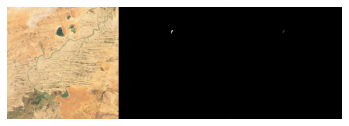

i= 18 loss= 0.16230963170528412 val_loss= 0.26899419724941254 mean_iou= 0.7905266 val_mean_iou= 0.33716154
196.7339


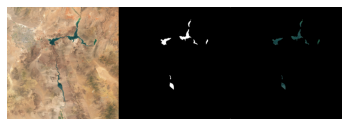

i= 19 loss= 0.1693167438109716 val_loss= 0.37714383006095886 mean_iou= 0.83592606 val_mean_iou= 0.28026235
227.31688


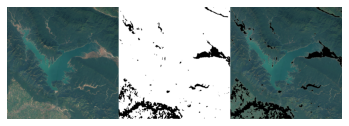

i= 20 loss= 0.16411059846480688 val_loss= 0.2640816941857338 mean_iou= 0.7669415 val_mean_iou= 0.4303355
88.65128


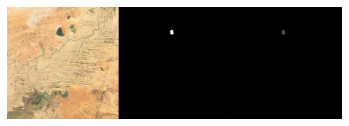

i= 21 loss= 0.1819442758957545 val_loss= 0.27460287511348724 mean_iou= 0.6872699 val_mean_iou= 0.43921193
177.8302


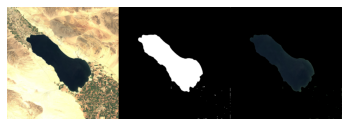

i= 22 loss= 0.19539701441923776 val_loss= 0.3147466704249382 mean_iou= 0.7750628 val_mean_iou= 0.4426203
232.84889


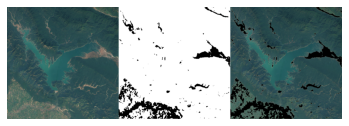

i= 23 loss= 0.17977512379487356 val_loss= 0.37391845136880875 mean_iou= 0.7376272 val_mean_iou= 0.38654256
240.79434


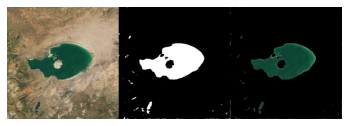

i= 24 loss= 0.23244700332482657 val_loss= 0.31813472509384155 mean_iou= 0.6161571 val_mean_iou= 0.40990436
238.55688


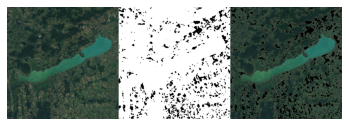

i= 25 loss= 0.1714863727490107 val_loss= 0.24652926623821259 mean_iou= 0.7915971 val_mean_iou= 0.48123217
251.55537


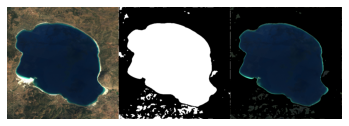

i= 26 loss= 0.2012915164232254 val_loss= 0.22822006046772003 mean_iou= 0.63923407 val_mean_iou= 0.44562903
252.83455


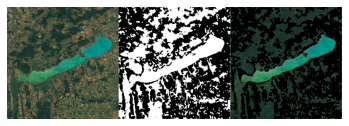

i= 27 loss= 0.1900563140710195 val_loss= 0.28788210451602936 mean_iou= 0.7395112 val_mean_iou= 0.394243
241.96657


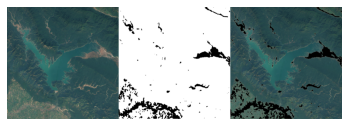

i= 28 loss= 0.2003770669301351 val_loss= 0.15083932131528854 mean_iou= 0.7264698 val_mean_iou= 0.64783573
68.87176


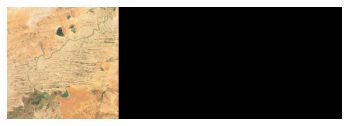

i= 29 loss= 0.1516974667708079 val_loss= 0.17308394610881805 mean_iou= 0.8014924 val_mean_iou= 0.62518597
141.89847


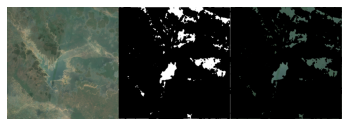

i= 30 loss= 0.17673326532046 val_loss= 0.14280538260936737 mean_iou= 0.811718 val_mean_iou= 0.74926317
242.92323


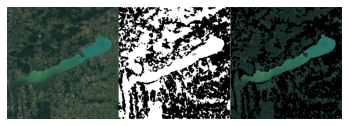

i= 31 loss= 0.1781696875890096 val_loss= 0.1611107736825943 mean_iou= 0.750766 val_mean_iou= 0.6671114
253.9044


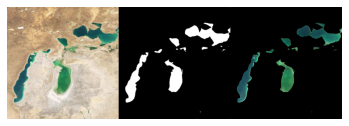

i= 32 loss= 0.1828294595082601 val_loss= 0.12437665462493896 mean_iou= 0.736012 val_mean_iou= 0.78231764
229.62155


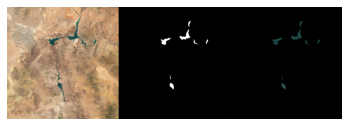

i= 33 loss= 0.153213232755661 val_loss= 0.13106970116496086 mean_iou= 0.73373914 val_mean_iou= 0.7736352
212.77429


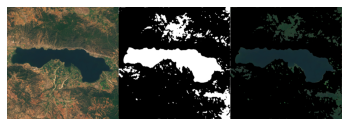

i= 34 loss= 0.15560908118883768 val_loss= 0.2117687165737152 mean_iou= 0.7949746 val_mean_iou= 0.6343668
254.79353


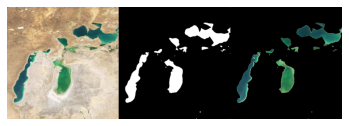

i= 35 loss= 0.2041019449631373 val_loss= 0.12469106167554855 mean_iou= 0.6989855 val_mean_iou= 0.7968216
190.75436


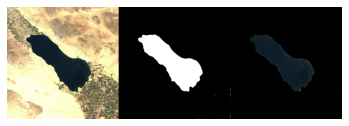

i= 36 loss= 0.1772891233364741 val_loss= 0.13892297074198723 mean_iou= 0.6881962 val_mean_iou= 0.7686525
254.47527


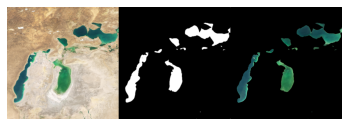

i= 37 loss= 0.24671059846878052 val_loss= 0.1999628245830536 mean_iou= 0.5242718 val_mean_iou= 0.6315281
237.49988


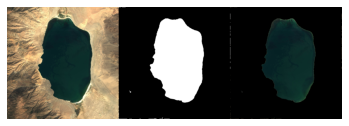

i= 38 loss= 0.14514297991991043 val_loss= 0.12765593826770782 mean_iou= 0.81476253 val_mean_iou= 0.7353626
254.89893


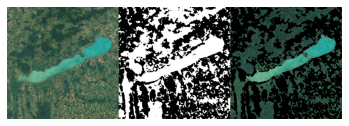

i= 39 loss= 0.18184208869934082 val_loss= 0.14216383546590805 mean_iou= 0.7012048 val_mean_iou= 0.66986
254.99057


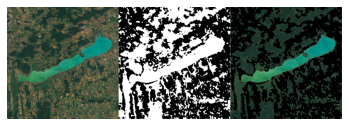

i= 40 loss= 0.13834927479426065 val_loss= 0.16446849703788757 mean_iou= 0.76812387 val_mean_iou= 0.6329503
241.83325


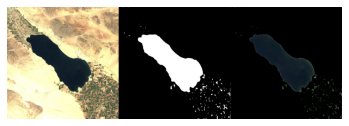

i= 41 loss= 0.1506786992152532 val_loss= 0.13162337988615036 mean_iou= 0.7157569 val_mean_iou= 0.6886953
236.94273


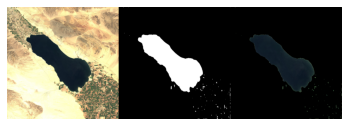

i= 42 loss= 0.19064015646775564 val_loss= 0.11976812407374382 mean_iou= 0.737374 val_mean_iou= 0.73653513
229.07765


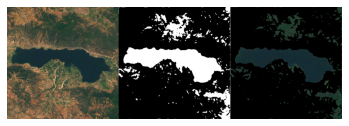

i= 43 loss= 0.12011853108803432 val_loss= 0.15115967020392418 mean_iou= 0.8146088 val_mean_iou= 0.63676167
240.00609


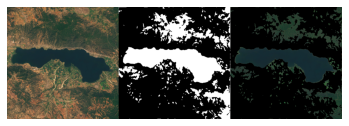

i= 44 loss= 0.12553312629461288 val_loss= 0.1060418076813221 mean_iou= 0.79412025 val_mean_iou= 0.7214613
254.9738


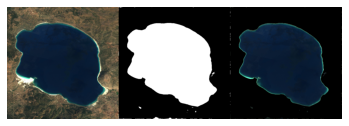

i= 45 loss= 0.18462906777858734 val_loss= 0.1677430421113968 mean_iou= 0.6260256 val_mean_iou= 0.5714084
254.98611


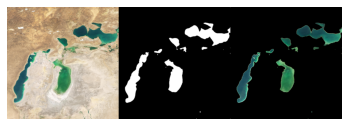

i= 46 loss= 0.15039062996705374 val_loss= 0.09228049591183662 mean_iou= 0.7541516 val_mean_iou= 0.72151875
254.74544


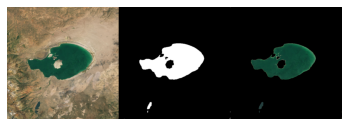

i= 47 loss= 0.10784519960482915 val_loss= 0.1078171581029892 mean_iou= 0.82982206 val_mean_iou= 0.6514615
242.46606


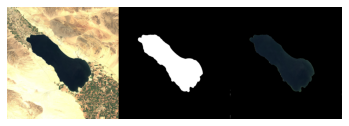

i= 48 loss= 0.15915391594171524 val_loss= 0.14970310777425766 mean_iou= 0.6442187 val_mean_iou= 0.6432882
250.80542


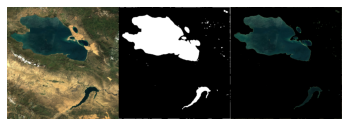

i= 49 loss= 0.17195719480514526 val_loss= 0.15146902576088905 mean_iou= 0.7746579 val_mean_iou= 0.63091403
254.49274


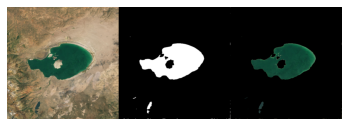

i= 50 loss= 0.14511796087026596 val_loss= 0.13693026080727577 mean_iou= 0.80020696 val_mean_iou= 0.65601504
236.97432


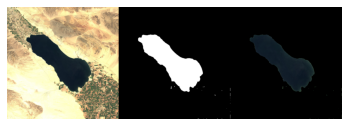

i= 51 loss= 0.12045367807149887 val_loss= 0.18217625468969345 mean_iou= 0.80983424 val_mean_iou= 0.532779
254.99063


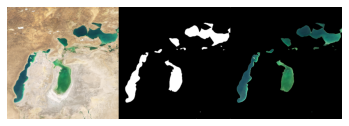

i= 52 loss= 0.11123245706160863 val_loss= 0.13615617901086807 mean_iou= 0.8760288 val_mean_iou= 0.6598638
254.69247


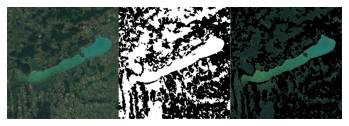

i= 53 loss= 0.16966339449087778 val_loss= 0.29920609295368195 mean_iou= 0.7808289 val_mean_iou= 0.5248246
253.98357


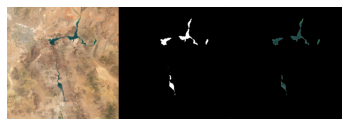

i= 54 loss= 0.10921589285135269 val_loss= 0.22974494844675064 mean_iou= 0.82427186 val_mean_iou= 0.5883715
251.07187


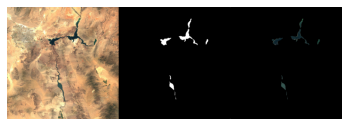

i= 55 loss= 0.1625047226746877 val_loss= 0.29989244043827057 mean_iou= 0.7198643 val_mean_iou= 0.57266116
254.94867


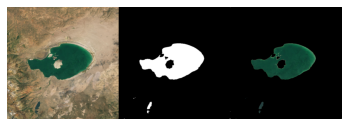

i= 56 loss= 0.1546705017487208 val_loss= 0.28915072977542877 mean_iou= 0.76431054 val_mean_iou= 0.6119187
242.44273


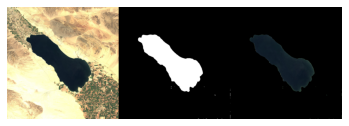

i= 57 loss= 0.10279667129119237 val_loss= 0.34741830080747604 mean_iou= 0.8781974 val_mean_iou= 0.5878521
254.98824


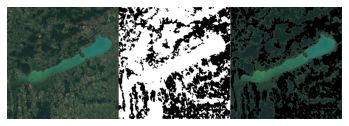

i= 58 loss= 0.10460297514994939 val_loss= 0.18243098631501198 mean_iou= 0.8648786 val_mean_iou= 0.72260547
77.91738


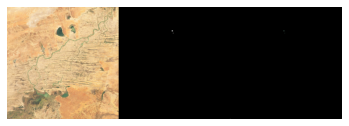

i= 59 loss= 0.18940558036168417 val_loss= 0.17363116890192032 mean_iou= 0.69608146 val_mean_iou= 0.6979152
233.68205


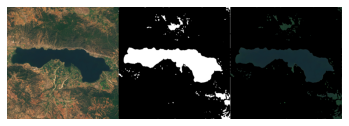

i= 60 loss= 0.14673090477784476 val_loss= 0.47475482523441315 mean_iou= 0.772268 val_mean_iou= 0.5305616
254.9976


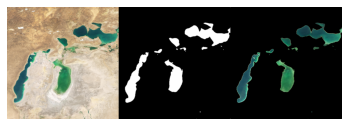

i= 61 loss= 0.12180616458257039 val_loss= 0.6579949855804443 mean_iou= 0.83599263 val_mean_iou= 0.46366635
245.98041


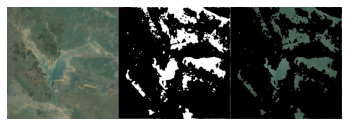

i= 62 loss= 0.12020706385374069 val_loss= 0.19911940395832062 mean_iou= 0.83036834 val_mean_iou= 0.68251514
245.69759


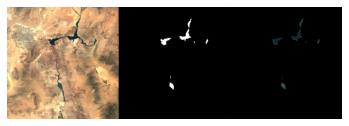

i= 63 loss= 0.13610336432854334 val_loss= 0.4877519905567169 mean_iou= 0.7874601 val_mean_iou= 0.52161115
254.99887


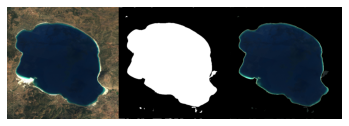

i= 64 loss= 0.24943612019220987 val_loss= 0.7434621155261993 mean_iou= 0.6883262 val_mean_iou= 0.44886488
253.8157


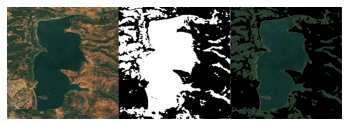

i= 65 loss= 0.14490661770105362 val_loss= 0.2716115564107895 mean_iou= 0.804972 val_mean_iou= 0.5592385
254.98254


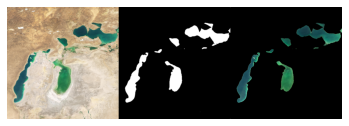

i= 66 loss= 0.14595061292250952 val_loss= 0.38401302695274353 mean_iou= 0.80286056 val_mean_iou= 0.5595665
254.99997


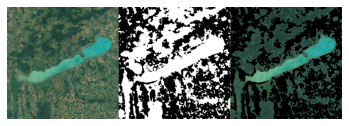

i= 67 loss= 0.12519882371028265 val_loss= 0.5338752269744873 mean_iou= 0.748501 val_mean_iou= 0.5266766
254.99947


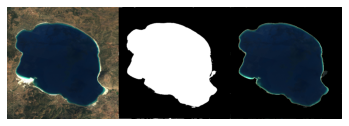

i= 68 loss= 0.12452428291241328 val_loss= 0.3091464042663574 mean_iou= 0.828868 val_mean_iou= 0.5880298
254.90187


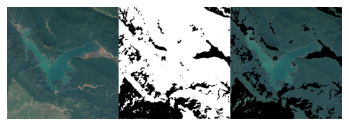

i= 69 loss= 0.8339912270506223 val_loss= 1.2348839044570923 mean_iou= 0.5571199 val_mean_iou= 0.18938449
254.99945


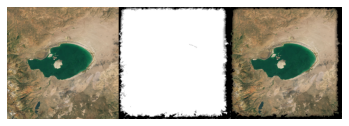

i= 70 loss= 0.5424851973851522 val_loss= 0.168349988758564 mean_iou= 0.50944567 val_mean_iou= 0.6837754
254.92747


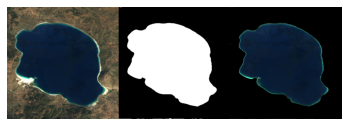

i= 71 loss= 0.15687517821788788 val_loss= 0.19265460222959518 mean_iou= 0.77062553 val_mean_iou= 0.59072316
72.15927


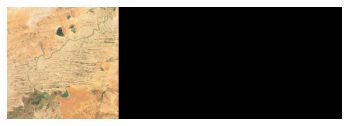

i= 72 loss= 0.11121756086746852 val_loss= 0.2348942756652832 mean_iou= 0.84874415 val_mean_iou= 0.5680773
254.73262


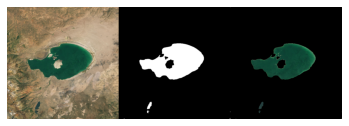

i= 73 loss= 0.11431757360696793 val_loss= 0.2715630978345871 mean_iou= 0.8588493 val_mean_iou= 0.5791421
242.48927


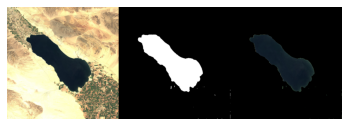

i= 74 loss= 0.15647534529368082 val_loss= 0.3426762670278549 mean_iou= 0.65943176 val_mean_iou= 0.5130045
255.0


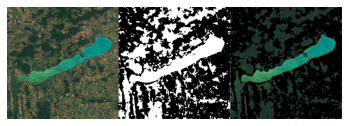

i= 75 loss= 0.14909067998329797 val_loss= 0.21485816687345505 mean_iou= 0.68702537 val_mean_iou= 0.64383006
254.47331


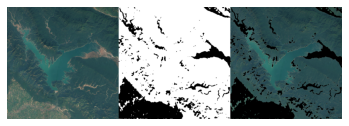

i= 76 loss= 0.09013821929693222 val_loss= 0.137685626745224 mean_iou= 0.8895426 val_mean_iou= 0.7545116
246.62723


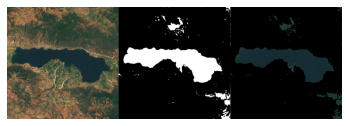

i= 77 loss= 0.11129861573378245 val_loss= 0.33604804426431656 mean_iou= 0.82133365 val_mean_iou= 0.5804852
254.6102


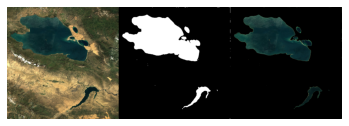

i= 78 loss= 0.11621083815892537 val_loss= 0.2849943935871124 mean_iou= 0.8593665 val_mean_iou= 0.6134479
254.61841


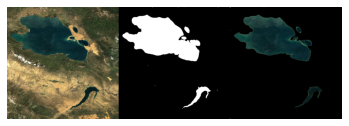

i= 79 loss= 0.11283237983783086 val_loss= 0.22474174201488495 mean_iou= 0.8385296 val_mean_iou= 0.6816493
250.88943


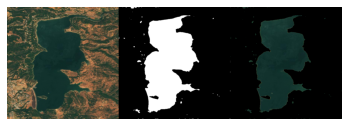

i= 80 loss= 0.09830075750748317 val_loss= 0.4787628948688507 mean_iou= 0.8498618 val_mean_iou= 0.5252291
248.36124


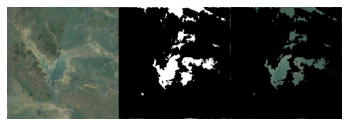

i= 81 loss= 0.6811429758866628 val_loss= 0.2749577835202217 mean_iou= 0.54856026 val_mean_iou= 0.56076545
254.99562


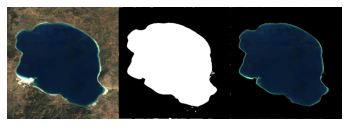

i= 82 loss= 0.12687716633081436 val_loss= 0.16179313510656357 mean_iou= 0.77817327 val_mean_iou= 0.6308569
254.9976


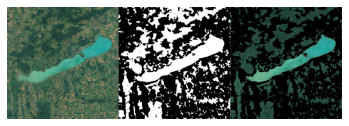

i= 83 loss= 0.1502971053123474 val_loss= 0.29761476814746857 mean_iou= 0.79947025 val_mean_iou= 0.53336066
254.84564


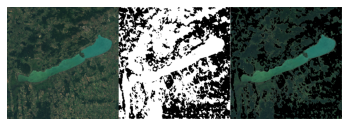

i= 84 loss= 0.14195229609807333 val_loss= 0.21076685190200806 mean_iou= 0.8010328 val_mean_iou= 0.62599885
254.99724


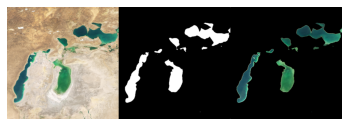

i= 85 loss= 0.13842783371607462 val_loss= 0.2771081440150738 mean_iou= 0.8216102 val_mean_iou= 0.6660096
254.25563


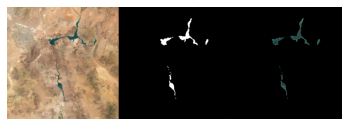

i= 86 loss= 0.18897943198680878 val_loss= 0.2349833846092224 mean_iou= 0.71553355 val_mean_iou= 0.7034329
254.99788


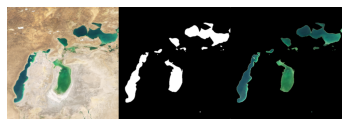

i= 87 loss= 0.11982512970765431 val_loss= 0.16323675587773323 mean_iou= 0.84792536 val_mean_iou= 0.7164187
254.34062


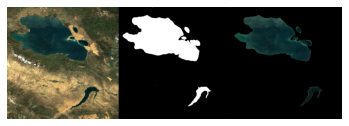

i= 88 loss= 0.12230872362852097 val_loss= 0.25720689445734024 mean_iou= 0.7545859 val_mean_iou= 0.55190074
254.9982


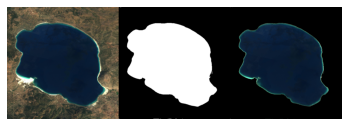

i= 89 loss= 0.120827483634154 val_loss= 0.27584703266620636 mean_iou= 0.8194048 val_mean_iou= 0.46454614
254.99979


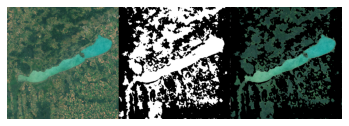

i= 90 loss= 0.11571817969282468 val_loss= 0.6133435666561127 mean_iou= 0.8521419 val_mean_iou= 0.40471816
253.82149


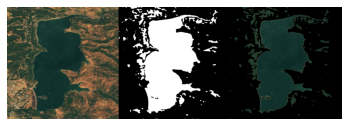

i= 91 loss= 0.12804991751909256 val_loss= 0.5153974294662476 mean_iou= 0.7760678 val_mean_iou= 0.39786637
253.41634


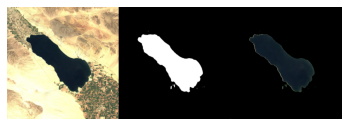

i= 92 loss= 0.11073593546946843 val_loss= 0.6292371153831482 mean_iou= 0.84427935 val_mean_iou= 0.38474298
254.87935


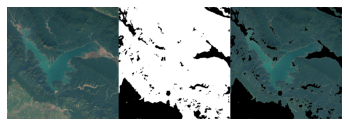

i= 93 loss= 0.14693894237279892 val_loss= 0.8380930721759796 mean_iou= 0.65379655 val_mean_iou= 0.4774225
254.9999


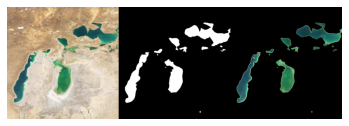

i= 94 loss= 0.09392782052357991 val_loss= 0.36017755046486855 mean_iou= 0.8967082 val_mean_iou= 0.59582925
249.59042


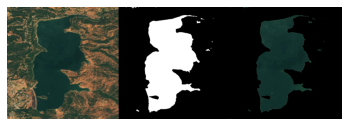

i= 95 loss= 0.0756579947968324 val_loss= 0.08852346986532211 mean_iou= 0.9097631 val_mean_iou= 0.7485161
252.66188


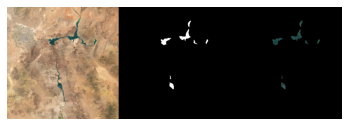

i= 96 loss= 0.16893668472766876 val_loss= 0.34927889704704285 mean_iou= 0.7376005 val_mean_iou= 0.42621818
253.47972


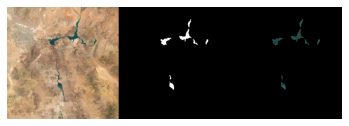

i= 97 loss= 0.10608145594596863 val_loss= 0.34953567385673523 mean_iou= 0.85641927 val_mean_iou= 0.41615522
254.8557


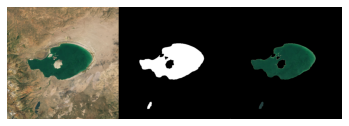

i= 98 loss= 0.11941395451625188 val_loss= 0.5412429943680763 mean_iou= 0.8131184 val_mean_iou= 0.43248203
254.9983


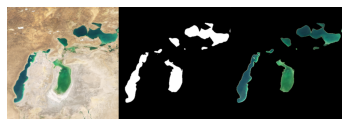

i= 99 loss= 0.10897371917963028 val_loss= 0.7792889773845673 mean_iou= 0.7887719 val_mean_iou= 0.36554134
251.95038


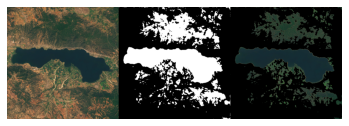

i= 100 loss= 0.13500537474950156 val_loss= 1.0524404644966125 mean_iou= 0.7512865 val_mean_iou= 0.3423991
254.99675


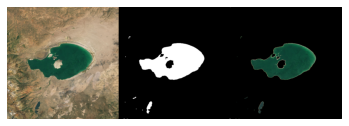

In [19]:
history = model.fit_generator(train_generator, 
                    epochs = 100, steps_per_epoch = train_steps,
                    validation_data = test_generator, validation_steps = test_steps,
                    callbacks = build_callbacks(), verbose = 0,
                    use_multiprocessing=True)

In [ ]:
#history.model.save_weights()

#### Training with image augmentation

In the previous Part we saw how to use the ```ImageDataGenerator``` class in ```keras```, which we use below to generate batches of 1 images randomly rotated up to 45 degrees, flipped horizontally, and/or zoomed in/out up to 20%

In [20]:
# generate batches of one because the generator will be used
# to print imagery to file

batch_size=1

train_datagen = tf.keras.preprocessing.image.ImageDataGenerator(
        featurewise_center=False,
        featurewise_std_normalization=False,     
        shear_range=0,
        zoom_range=0.2,
        rotation_range=45,
        horizontal_flip=True)

img_generator = train_datagen.flow_from_directory(    
        's2cloudless_imagery',
        target_size=(2048, 2048), #opt for a fairly small image size for memory efficiency
        batch_size=batch_size,
        class_mode=None, seed=111, shuffle=False)

test_datagen = tf.keras.preprocessing.image.ImageDataGenerator(
        featurewise_center=False,
        featurewise_std_normalization=False,     
        shear_range=0,
        zoom_range=0.2,
        rotation_range=45,
        horizontal_flip=True)

mask_generator = test_datagen.flow_from_directory(
        's2cloudless_label_imagery',
        target_size=(2048, 2048),
        batch_size=batch_size,
        class_mode=None, seed=111, shuffle=False)

Found 40 images belonging to 1 classes.
Found 40 images belonging to 1 classes.


Convert each image and label image to floating point between 0 and 1 while combing the two generators, then generate and save to file 100 augmented images and associated labels

In [21]:
n_aug_files = 100

train_generator2 = (tuple(np.array(pair, dtype='float64')/255) for pair in zip(img_generator, mask_generator))

counter = 0
while counter<n_aug_files:
    x, y = next(train_generator2)
    matplotlib.image.imsave('s2cloudless_label_imagery'+os.sep+'data'+os.sep+"augimage00"+str(counter)+".jpg_mask.jpg", np.squeeze(y[0])) 
    matplotlib.image.imsave('s2cloudless_imagery'+os.sep+'data'+os.sep+"augimage00"+str(counter)+".jpg", np.squeeze(x[0]))    
    counter += 1

While the above is running, you can check in the file folders to see the new augmented imagery

(in case you want to undo the above, uncomment and run the cell below)

In [ ]:
#! rm s2cloudless_label_imagery/data/aug*.jpg
#! rm s2cloudless_imagery/data/aug*.jpg

Shuffle files again to pick a new set of training and testing files, and refine the test and train generators for the next round of tests

In [22]:
#batch size can now be higher because you have a function 
#generating augmented imagery
batch_size = 16

shuffle(all_files)

split = int(prop_train * len(all_files))

#split into training and testing
train_files = all_files[0:split]
test_files  = all_files[split:]

train_steps = len(train_files) //batch_size
test_steps = len(test_files) //batch_size

print('Steps per training epoch: %i' % (train_steps))
print('Steps per testing epoch: %i' % (test_steps))

train_generator = image_batch_generator(train_files, batch_size = batch_size)
test_generator  = image_batch_generator(test_files, batch_size = batch_size)

Steps per training epoch: 1
Steps per testing epoch: 1


Remove the previous model weights file and run the model training function again, this time using augmented imagery, and double the training epochs (200) to capitalize on the model having more training data

In [23]:
os.remove('unet.h5')

By using a checkpoint weights file, you could use smaller numbers of epochs and repeatedly run the cell below. However, that will meann it is harder to keep track of training history

i= 1 loss= 0.38578519225120544 val_loss= 0.12937584519386292 mean_iou= 0.5123115 val_mean_iou= 0.76344377
243.94466


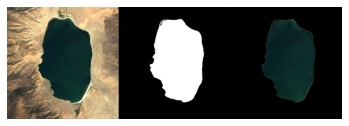

i= 2 loss= 0.1190120130777359 val_loss= 0.11573774367570877 mean_iou= 0.7886528 val_mean_iou= 0.78753346
254.44582


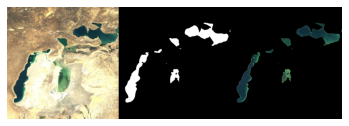

i= 3 loss= 0.13915196061134338 val_loss= 0.22276610136032104 mean_iou= 0.73915917 val_mean_iou= 0.40584996
176.8581


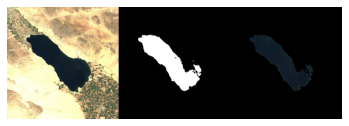

i= 4 loss= 0.1937527358531952 val_loss= 0.1359633207321167 mean_iou= 0.48033443 val_mean_iou= 0.7494337
244.71547


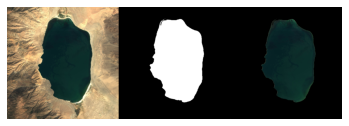

i= 5 loss= 0.1335289031267166 val_loss= 0.11769703775644302 mean_iou= 0.8130122 val_mean_iou= 0.76637787
94.38391


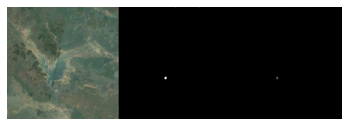

i= 6 loss= 0.11974992603063583 val_loss= 0.18836522102355957 mean_iou= 0.7803682 val_mean_iou= 0.5388812
194.39243


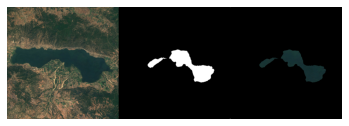

i= 7 loss= 0.12273065000772476 val_loss= 0.10906577855348587 mean_iou= 0.74515563 val_mean_iou= 0.7795398
254.09972


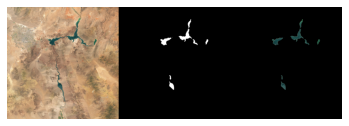

i= 8 loss= 0.11656506359577179 val_loss= 0.1161896139383316 mean_iou= 0.8149081 val_mean_iou= 0.77103233
246.33293


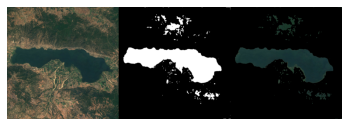

i= 9 loss= 0.1206856444478035 val_loss= 0.1445424109697342 mean_iou= 0.7828517 val_mean_iou= 0.70861727
69.556305


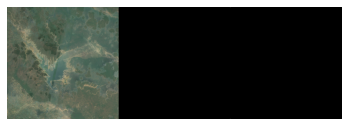

i= 10 loss= 0.11782948672771454 val_loss= 0.10315428674221039 mean_iou= 0.79714936 val_mean_iou= 0.7910703
254.99988


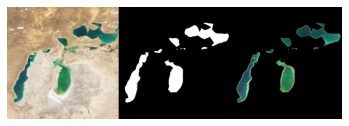

i= 11 loss= 0.08673105388879776 val_loss= 0.09542225301265717 mean_iou= 0.8585405 val_mean_iou= 0.8183113
254.99924


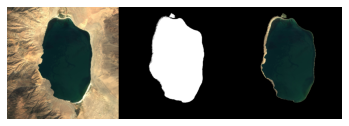

i= 12 loss= 0.11532291769981384 val_loss= 0.17603124678134918 mean_iou= 0.7434254 val_mean_iou= 0.6663069
248.07205


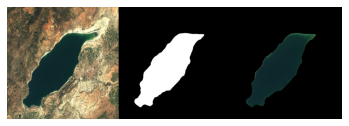

i= 13 loss= 0.23160216212272644 val_loss= 2.0187456607818604 mean_iou= 0.53305125 val_mean_iou= 0.20507154
255.0


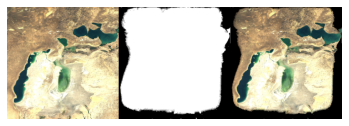

i= 14 loss= 1.5592398643493652 val_loss= 0.13436855375766754 mean_iou= 0.24473025 val_mean_iou= 0.781564
231.15828


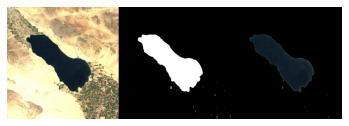

i= 15 loss= 0.19757719337940216 val_loss= 0.15020044147968292 mean_iou= 0.7150731 val_mean_iou= 0.7280643
248.04117


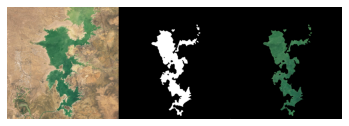

i= 16 loss= 0.11013099551200867 val_loss= 0.14242908358573914 mean_iou= 0.81935126 val_mean_iou= 0.7318947
248.74043


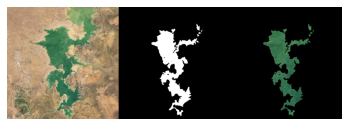

i= 17 loss= 0.24226416647434235 val_loss= 0.15498387813568115 mean_iou= 0.5154218 val_mean_iou= 0.60979646
233.47292


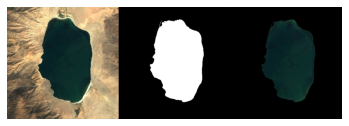

i= 18 loss= 0.11423240602016449 val_loss= 0.1373736411333084 mean_iou= 0.72663695 val_mean_iou= 0.6884875
73.577866


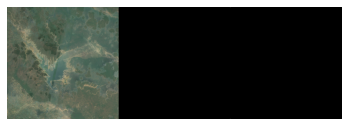

i= 19 loss= 0.08510591834783554 val_loss= 0.12008116394281387 mean_iou= 0.8934251 val_mean_iou= 0.7508553
254.99088


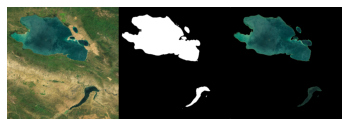

i= 20 loss= 0.09485892206430435 val_loss= 0.13289585709571838 mean_iou= 0.888104 val_mean_iou= 0.7202376
254.98073


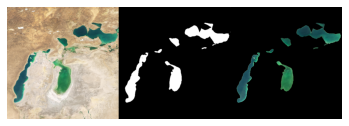

i= 21 loss= 0.11590828001499176 val_loss= 0.12408167123794556 mean_iou= 0.794196 val_mean_iou= 0.7419401
77.81555


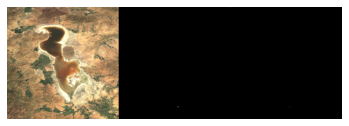

i= 22 loss= 0.1975768506526947 val_loss= 0.14380614459514618 mean_iou= 0.6206976 val_mean_iou= 0.639888
229.96944


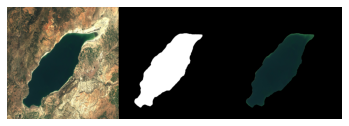

i= 23 loss= 0.09832290560007095 val_loss= 0.12969952821731567 mean_iou= 0.8043864 val_mean_iou= 0.6952044
57.683952


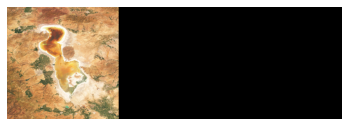

i= 24 loss= 0.08248994499444962 val_loss= 0.11623097211122513 mean_iou= 0.8578095 val_mean_iou= 0.6971591
251.5816


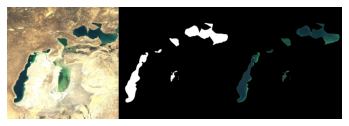

i= 25 loss= 0.10242602229118347 val_loss= 0.10085982084274292 mean_iou= 0.8447449 val_mean_iou= 0.7620386
202.24701


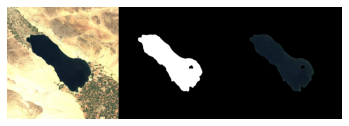

i= 26 loss= 0.08815423399209976 val_loss= 0.1065160408616066 mean_iou= 0.8113763 val_mean_iou= 0.7628525
246.83415


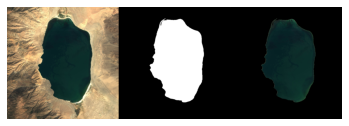

i= 27 loss= 0.12693485617637634 val_loss= 0.1374901831150055 mean_iou= 0.7388615 val_mean_iou= 0.60231346
237.29001


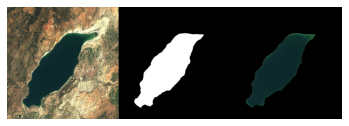

i= 28 loss= 0.11294477432966232 val_loss= 0.10894957184791565 mean_iou= 0.82099324 val_mean_iou= 0.7204819
253.83647


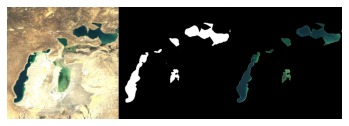

i= 29 loss= 0.07366440445184708 val_loss= 0.12055552750825882 mean_iou= 0.9150388 val_mean_iou= 0.70380735
254.99629


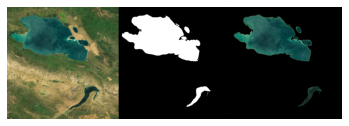

i= 30 loss= 0.12394031882286072 val_loss= 0.13776913285255432 mean_iou= 0.6795508 val_mean_iou= 0.56536365
204.14885


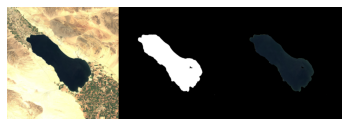

i= 31 loss= 0.10071848332881927 val_loss= 0.12136644870042801 mean_iou= 0.8551328 val_mean_iou= 0.6490032
66.46237


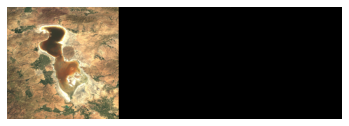

i= 32 loss= 0.08795324712991714 val_loss= 0.13339367508888245 mean_iou= 0.8604489 val_mean_iou= 0.6661571
208.62416


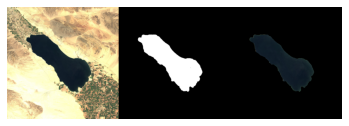

i= 33 loss= 0.08123483508825302 val_loss= 0.14020298421382904 mean_iou= 0.7848235 val_mean_iou= 0.70811385
254.98459


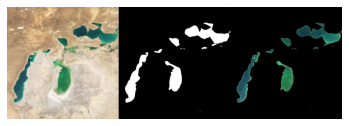

i= 34 loss= 0.17286023497581482 val_loss= 0.19215360283851624 mean_iou= 0.688298 val_mean_iou= 0.51338667
254.95805


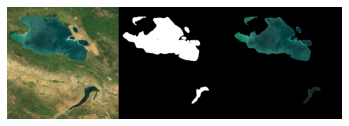

i= 35 loss= 0.1644851416349411 val_loss= 0.12411476671695709 mean_iou= 0.63616925 val_mean_iou= 0.70091444
68.69992


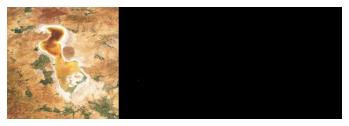

i= 36 loss= 0.12736451625823975 val_loss= 0.09886030852794647 mean_iou= 0.73839056 val_mean_iou= 0.76793385
254.9755


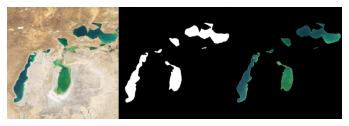

i= 37 loss= 0.10275119543075562 val_loss= 0.10170994699001312 mean_iou= 0.817581 val_mean_iou= 0.7790449
230.44022


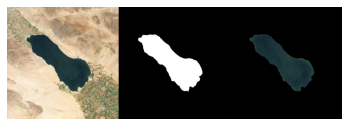

i= 38 loss= 0.08642319589853287 val_loss= 0.09957733005285263 mean_iou= 0.8814451 val_mean_iou= 0.80086625
253.13028


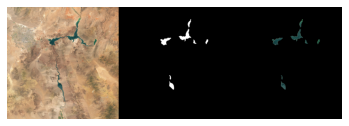

i= 39 loss= 0.0588127076625824 val_loss= 0.10025317966938019 mean_iou= 0.87884253 val_mean_iou= 0.8067523
253.49619


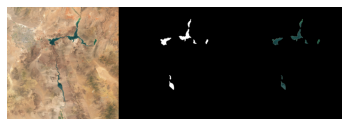

i= 40 loss= 0.07848861813545227 val_loss= 0.10085263103246689 mean_iou= 0.8608772 val_mean_iou= 0.82341176
240.15147


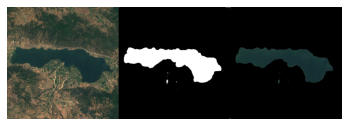

i= 41 loss= 0.07089035212993622 val_loss= 0.10685820132493973 mean_iou= 0.8547576 val_mean_iou= 0.8014738
60.537956


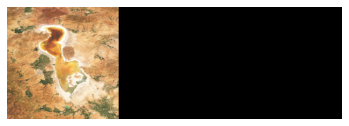

i= 42 loss= 0.06164681911468506 val_loss= 0.12308762967586517 mean_iou= 0.8903931 val_mean_iou= 0.7664334
244.81255


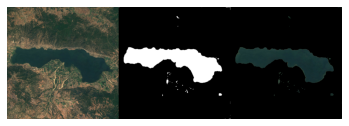

i= 43 loss= 0.07826168090105057 val_loss= 0.11002493649721146 mean_iou= 0.88503397 val_mean_iou= 0.817236
255.0


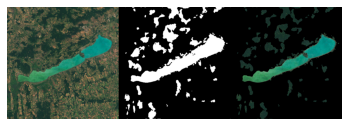

i= 44 loss= 0.08965086936950684 val_loss= 0.10820989310741425 mean_iou= 0.8137063 val_mean_iou= 0.8240465
252.91788


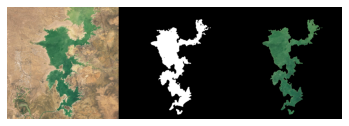

i= 45 loss= 0.05197416990995407 val_loss= 0.11267740279436111 mean_iou= 0.8635806 val_mean_iou= 0.8104692
254.16862


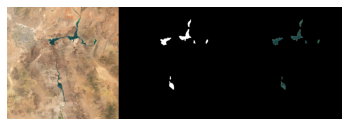

i= 46 loss= 0.1178005114197731 val_loss= 0.15344738960266113 mean_iou= 0.7527546 val_mean_iou= 0.77788204
214.6738


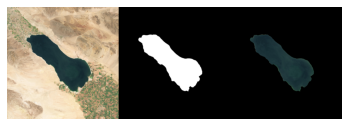

i= 47 loss= 0.2286258041858673 val_loss= 0.2381899505853653 mean_iou= 0.6044206 val_mean_iou= 0.6540594
254.99988


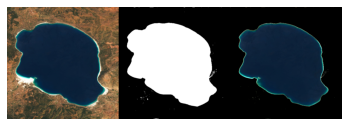

i= 48 loss= 0.14370901882648468 val_loss= 0.18796809017658234 mean_iou= 0.8386305 val_mean_iou= 0.64891034
254.99998


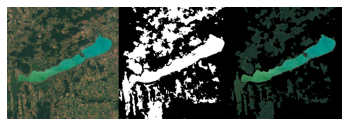

i= 49 loss= 0.11760376393795013 val_loss= 0.17807456851005554 mean_iou= 0.7481745 val_mean_iou= 0.76029414
251.08661


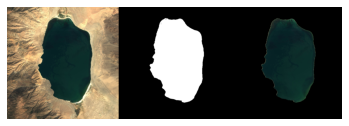

i= 50 loss= 0.08586961776018143 val_loss= 0.14613571763038635 mean_iou= 0.8623772 val_mean_iou= 0.7713049
251.97557


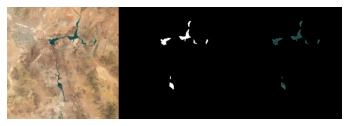

i= 51 loss= 0.10017329454421997 val_loss= 0.15390905737876892 mean_iou= 0.8153766 val_mean_iou= 0.74461955
248.737


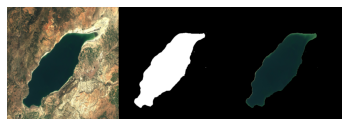

i= 52 loss= 0.08876635879278183 val_loss= 0.15313242375850677 mean_iou= 0.7492956 val_mean_iou= 0.73065966
60.59658


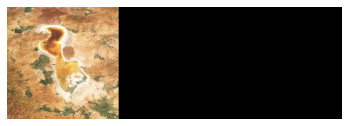

i= 53 loss= 0.07188447564840317 val_loss= 0.15327520668506622 mean_iou= 0.86061835 val_mean_iou= 0.7455963
254.99982


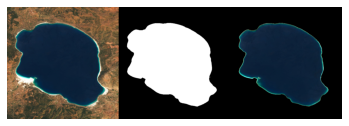

i= 54 loss= 0.07691746950149536 val_loss= 0.16272324323654175 mean_iou= 0.8759236 val_mean_iou= 0.6309338
254.99806


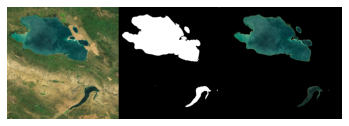

i= 55 loss= 0.10289230197668076 val_loss= 0.1674882173538208 mean_iou= 0.7829598 val_mean_iou= 0.6293587
252.376


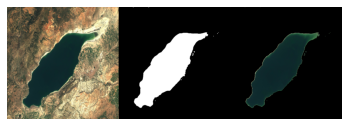

i= 56 loss= 0.06117112562060356 val_loss= 0.18594612181186676 mean_iou= 0.7723909 val_mean_iou= 0.6484818
255.0


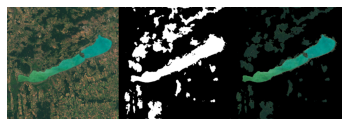

i= 57 loss= 0.1138276755809784 val_loss= 0.16778410971164703 mean_iou= 0.7100731 val_mean_iou= 0.6526025
146.84677


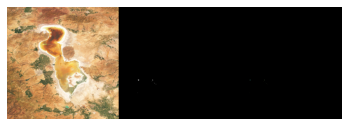

i= 58 loss= 0.10692168772220612 val_loss= 0.15418344736099243 mean_iou= 0.8751041 val_mean_iou= 0.68742883
254.99988


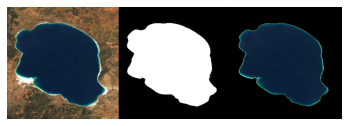

i= 59 loss= 0.08786166459321976 val_loss= 0.18187707662582397 mean_iou= 0.83661175 val_mean_iou= 0.59695214
60.341774


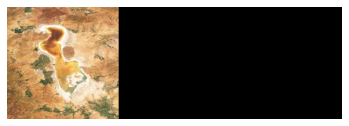

i= 60 loss= 0.0718911811709404 val_loss= 0.15402796864509583 mean_iou= 0.8881904 val_mean_iou= 0.6807101
254.99991


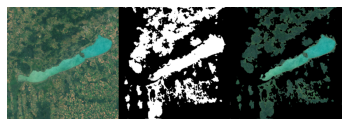

i= 61 loss= 0.09425827860832214 val_loss= 0.293673574924469 mean_iou= 0.8228273 val_mean_iou= 0.60781574
248.09456


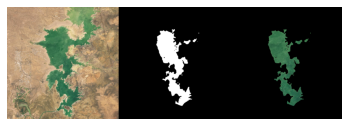

i= 62 loss= 0.17015379667282104 val_loss= 0.12051498889923096 mean_iou= 0.6169156 val_mean_iou= 0.7889371
192.40443


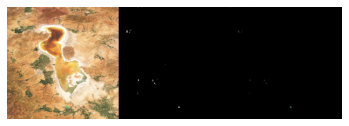

i= 63 loss= 0.182547926902771 val_loss= 0.13603830337524414 mean_iou= 0.66320056 val_mean_iou= 0.7420342
252.01544


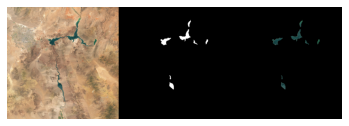

i= 64 loss= 0.0690576583147049 val_loss= 0.1409512460231781 mean_iou= 0.8915883 val_mean_iou= 0.74690485
254.99335


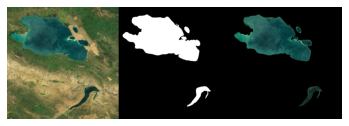

i= 65 loss= 0.10142448544502258 val_loss= 0.13121549785137177 mean_iou= 0.83516407 val_mean_iou= 0.74996805
252.93036


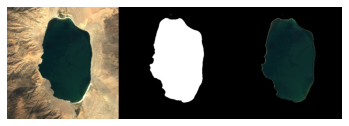

i= 66 loss= 0.08458007872104645 val_loss= 0.1478538066148758 mean_iou= 0.8590976 val_mean_iou= 0.69977933
71.27708


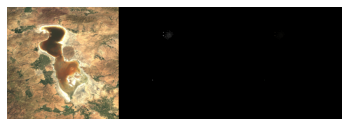

i= 67 loss= 0.0701180100440979 val_loss= 0.13344165682792664 mean_iou= 0.89806634 val_mean_iou= 0.7505278
254.12909


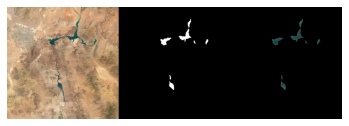

i= 68 loss= 0.07692539691925049 val_loss= 0.14370094239711761 mean_iou= 0.8861522 val_mean_iou= 0.73359764
100.99113


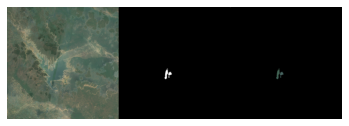

i= 69 loss= 0.04965028911828995 val_loss= 0.1361261010169983 mean_iou= 0.921294 val_mean_iou= 0.75501496
82.939835


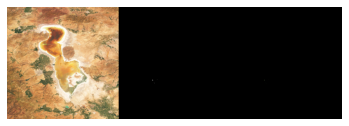

i= 70 loss= 0.09341327846050262 val_loss= 0.11885333806276321 mean_iou= 0.84550583 val_mean_iou= 0.7998173
254.99907


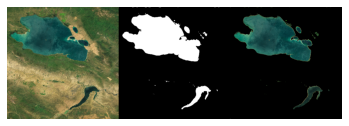

i= 71 loss= 0.0682511255145073 val_loss= 0.17073547840118408 mean_iou= 0.90728855 val_mean_iou= 0.7601501
254.99905


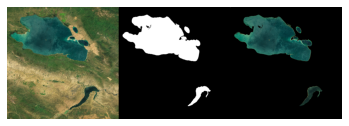

i= 72 loss= 0.0746571496129036 val_loss= 0.14426979422569275 mean_iou= 0.88106835 val_mean_iou= 0.76702464
249.94057


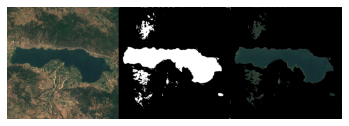

i= 73 loss= 0.12629859149456024 val_loss= 0.1654437780380249 mean_iou= 0.78527915 val_mean_iou= 0.7435678
252.68568


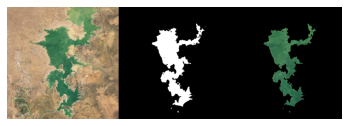

i= 74 loss= 0.10261213034391403 val_loss= 0.13169854879379272 mean_iou= 0.82078826 val_mean_iou= 0.77574915
179.8917


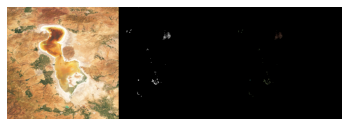

i= 75 loss= 0.08064942806959152 val_loss= 0.10895374417304993 mean_iou= 0.85621345 val_mean_iou= 0.8155207
254.99998


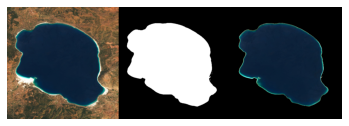

i= 76 loss= 0.05536685138940811 val_loss= 0.10562736541032791 mean_iou= 0.9106404 val_mean_iou= 0.7853812
253.53754


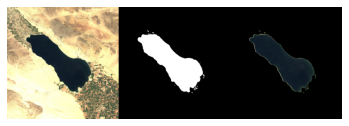

i= 77 loss= 0.0637613981962204 val_loss= 0.10489504039287567 mean_iou= 0.8888572 val_mean_iou= 0.8130569
254.79936


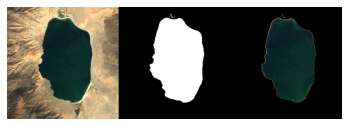

i= 78 loss= 0.06479662656784058 val_loss= 0.11262835562229156 mean_iou= 0.85853326 val_mean_iou= 0.78765285
255.0


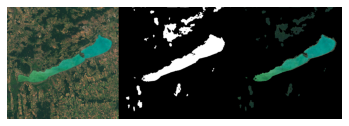

i= 79 loss= 0.08002650737762451 val_loss= 0.13228636980056763 mean_iou= 0.875909 val_mean_iou= 0.74766904
208.37852


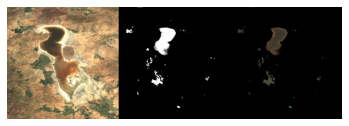

i= 80 loss= 0.08981075137853622 val_loss= 0.10899052768945694 mean_iou= 0.84741724 val_mean_iou= 0.8053324
254.35884


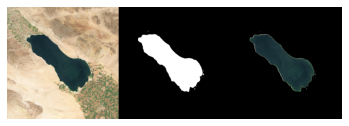

i= 81 loss= 0.07761140912771225 val_loss= 0.12037156522274017 mean_iou= 0.8975615 val_mean_iou= 0.7562173
152.89702


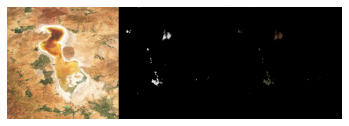

i= 82 loss= 0.05037542060017586 val_loss= 0.11188265681266785 mean_iou= 0.933038 val_mean_iou= 0.82239616
254.99988


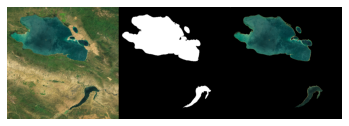

i= 83 loss= 0.09126630425453186 val_loss= 0.11999061703681946 mean_iou= 0.80986947 val_mean_iou= 0.8048841
254.83934


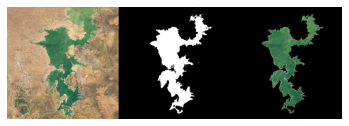

i= 84 loss= 0.10435903072357178 val_loss= 0.13158924877643585 mean_iou= 0.8393386 val_mean_iou= 0.81944126
254.4786


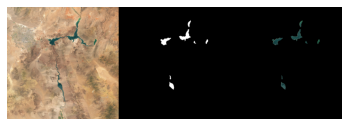

i= 85 loss= 0.09708958864212036 val_loss= 0.11321785300970078 mean_iou= 0.8671916 val_mean_iou= 0.8329362
255.0


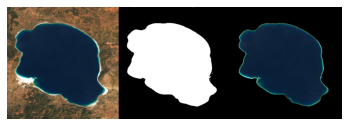

i= 86 loss= 0.0942944586277008 val_loss= 0.11453970521688461 mean_iou= 0.8021687 val_mean_iou= 0.8118609
253.42554


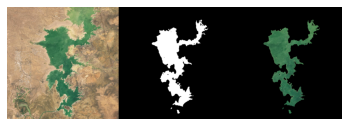

i= 87 loss= 0.09707561135292053 val_loss= 0.21274873614311218 mean_iou= 0.79506236 val_mean_iou= 0.69383174
254.39726


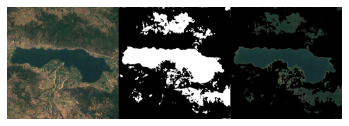

i= 88 loss= 0.23412460088729858 val_loss= 0.1069016307592392 mean_iou= 0.6985998 val_mean_iou= 0.84007645
254.53137


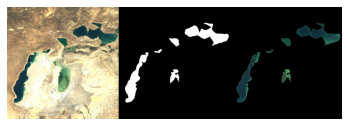

i= 89 loss= 0.08014269173145294 val_loss= 0.11639280617237091 mean_iou= 0.88399345 val_mean_iou= 0.8354766
251.72247


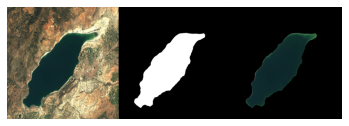

i= 90 loss= 0.09776312112808228 val_loss= 0.1234917864203453 mean_iou= 0.8348215 val_mean_iou= 0.80427146
254.98048


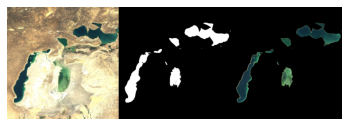

i= 91 loss= 0.09417035430669785 val_loss= 0.10879839956760406 mean_iou= 0.78272295 val_mean_iou= 0.83221114
254.96013


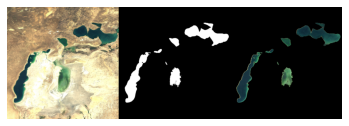

i= 92 loss= 0.08083891123533249 val_loss= 0.11047670245170593 mean_iou= 0.88937235 val_mean_iou= 0.82580936
254.99997


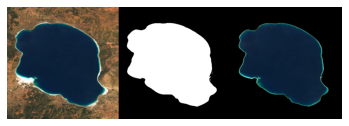

i= 93 loss= 0.06045448035001755 val_loss= 0.10903534293174744 mean_iou= 0.9071369 val_mean_iou= 0.8021908
255.0


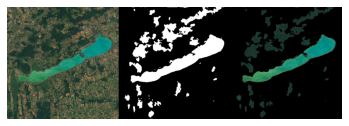

i= 94 loss= 0.08572398126125336 val_loss= 0.12451143562793732 mean_iou= 0.75210685 val_mean_iou= 0.77014905
174.53273


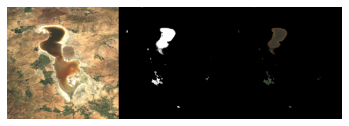

i= 95 loss= 0.05037154629826546 val_loss= 0.10052642226219177 mean_iou= 0.93183285 val_mean_iou= 0.83347934
253.99858


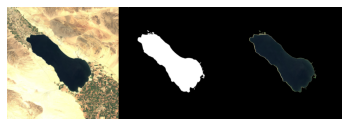

i= 96 loss= 0.03795982897281647 val_loss= 0.11054907739162445 mean_iou= 0.9259521 val_mean_iou= 0.80543536
154.67146


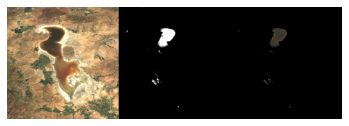

i= 97 loss= 0.06282716244459152 val_loss= 0.1273239254951477 mean_iou= 0.8683578 val_mean_iou= 0.7838162
255.0


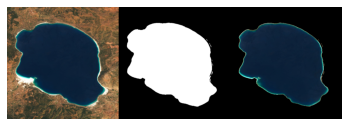

i= 98 loss= 0.06929689645767212 val_loss= 0.22281108796596527 mean_iou= 0.88581085 val_mean_iou= 0.6989176
244.92612


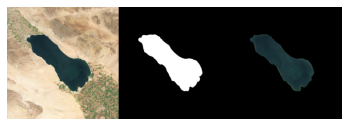

i= 99 loss= 0.23828592896461487 val_loss= 0.5680589079856873 mean_iou= 0.65437 val_mean_iou= 0.41740817
255.0


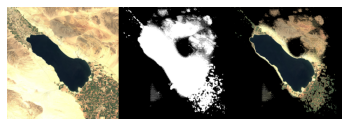

i= 100 loss= 0.4369086027145386 val_loss= 0.12224011868238449 mean_iou= 0.48097903 val_mean_iou= 0.8121492
254.99966


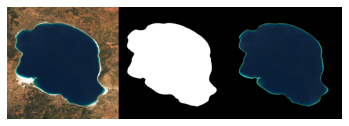

i= 101 loss= 0.11456378549337387 val_loss= 0.10774171352386475 mean_iou= 0.72695 val_mean_iou= 0.78272045
254.9998


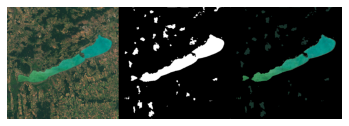

i= 102 loss= 0.12434746325016022 val_loss= 0.09760431200265884 mean_iou= 0.7654457 val_mean_iou= 0.8282559
254.99611


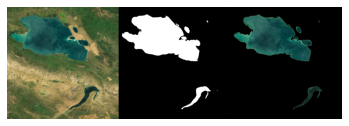

i= 103 loss= 0.11094771325588226 val_loss= 0.140105202794075 mean_iou= 0.7531517 val_mean_iou= 0.7053161
240.54015


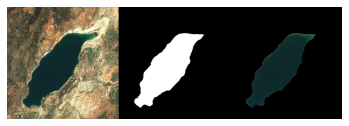

i= 104 loss= 0.12298640608787537 val_loss= 0.12066151946783066 mean_iou= 0.7515229 val_mean_iou= 0.7728262
62.935604


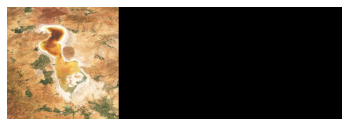

i= 105 loss= 0.08762005716562271 val_loss= 0.09839988499879837 mean_iou= 0.8498779 val_mean_iou= 0.8261358
254.99963


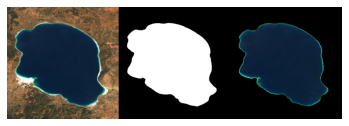

i= 106 loss= 0.07006674259901047 val_loss= 0.09936708211898804 mean_iou= 0.8740008 val_mean_iou= 0.7905337
254.99997


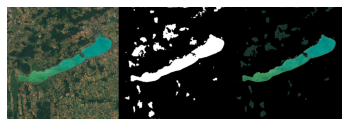

i= 107 loss= 0.13429409265518188 val_loss= 0.093133345246315 mean_iou= 0.6616757 val_mean_iou= 0.7861337
250.50159


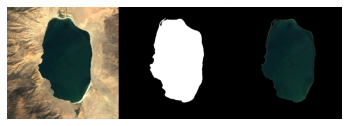

i= 108 loss= 0.06635328382253647 val_loss= 0.0994785949587822 mean_iou= 0.8534304 val_mean_iou= 0.76280963
255.0


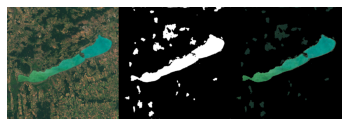

i= 109 loss= 0.10966362804174423 val_loss= 0.09401387721300125 mean_iou= 0.79458416 val_mean_iou= 0.7744471
75.39868


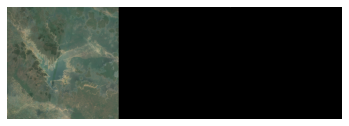

i= 110 loss= 0.09702562540769577 val_loss= 0.08503641933202744 mean_iou= 0.8464679 val_mean_iou= 0.7988939
253.65216


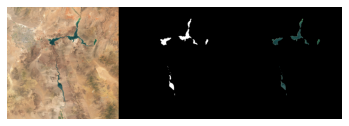

i= 111 loss= 0.06705125421285629 val_loss= 0.08712846785783768 mean_iou= 0.92386436 val_mean_iou= 0.79727244
243.64839


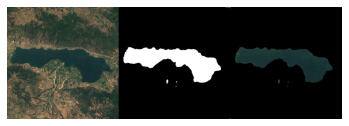

i= 112 loss= 0.07094188034534454 val_loss= 0.10465255379676819 mean_iou= 0.89249074 val_mean_iou= 0.792389
254.99135


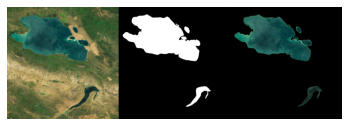

i= 113 loss= 0.09979519248008728 val_loss= 0.14100757241249084 mean_iou= 0.7981785 val_mean_iou= 0.6670826
245.09712


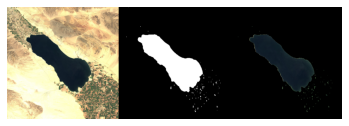

i= 114 loss= 0.08244014531373978 val_loss= 0.12022525072097778 mean_iou= 0.87660706 val_mean_iou= 0.8171263
250.50195


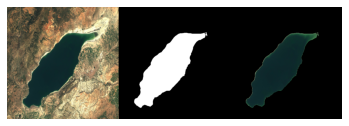

i= 115 loss= 0.11872127652168274 val_loss= 0.17835263907909393 mean_iou= 0.8227308 val_mean_iou= 0.64640003
254.99991


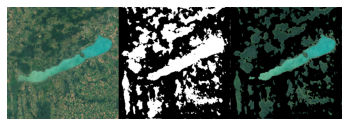

i= 116 loss= 0.08337300270795822 val_loss= 0.08743616193532944 mean_iou= 0.89698935 val_mean_iou= 0.8522122
246.13344


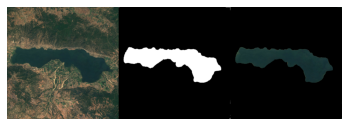

i= 117 loss= 0.07207038998603821 val_loss= 0.09594815224409103 mean_iou= 0.8599582 val_mean_iou= 0.81716776
254.9993


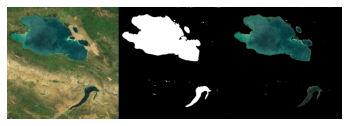

i= 118 loss= 0.08067771792411804 val_loss= 0.09023014456033707 mean_iou= 0.88891196 val_mean_iou= 0.8400882
99.92193


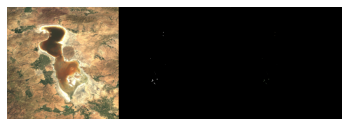

i= 119 loss= 0.0690712109208107 val_loss= 0.08892449736595154 mean_iou= 0.8371733 val_mean_iou= 0.8339359
91.764015


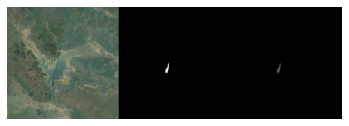

i= 120 loss= 0.08899909257888794 val_loss= 0.09139642119407654 mean_iou= 0.8480483 val_mean_iou= 0.84257144
254.99821


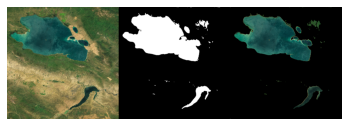

i= 121 loss= 0.07026945054531097 val_loss= 0.0740513801574707 mean_iou= 0.936652 val_mean_iou= 0.8871386
254.79655


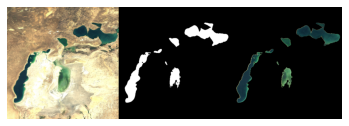

i= 122 loss= 0.10223770886659622 val_loss= 0.24552495777606964 mean_iou= 0.85883635 val_mean_iou= 0.6298537
255.0


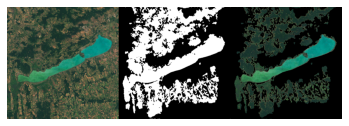

i= 123 loss= 0.10069811344146729 val_loss= 0.10535825788974762 mean_iou= 0.90209395 val_mean_iou= 0.8431012
254.99994


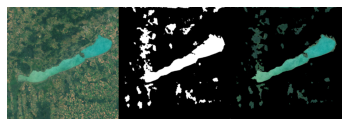

i= 124 loss= 0.08194450289011002 val_loss= 0.10667881369590759 mean_iou= 0.8678563 val_mean_iou= 0.82152295
254.99973


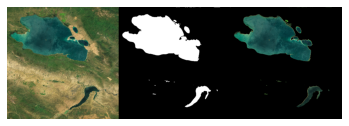

i= 125 loss= 0.06688536703586578 val_loss= 0.08431161940097809 mean_iou= 0.85282177 val_mean_iou= 0.86475027
254.91943


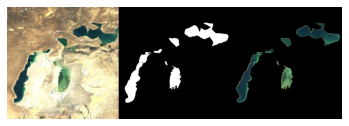

i= 126 loss= 0.06141214817762375 val_loss= 0.09374257922172546 mean_iou= 0.8933721 val_mean_iou= 0.84356254
255.0


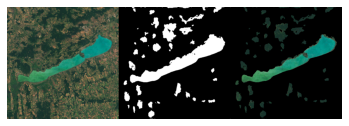

i= 127 loss= 0.08421280980110168 val_loss= 0.0779629498720169 mean_iou= 0.86676055 val_mean_iou= 0.8906197
254.99991


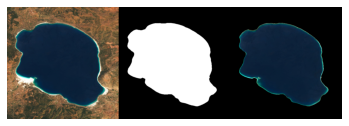

i= 128 loss= 0.10048132389783859 val_loss= 0.23347580432891846 mean_iou= 0.83057564 val_mean_iou= 0.6842183
255.0


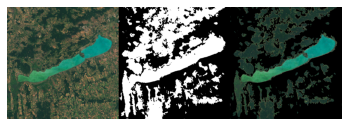

i= 129 loss= 0.1252065747976303 val_loss= 0.10822500288486481 mean_iou= 0.7519702 val_mean_iou= 0.83893645
254.99991


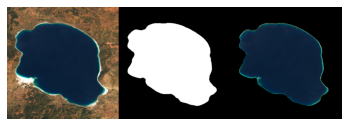

i= 130 loss= 0.11248123645782471 val_loss= 0.15511593222618103 mean_iou= 0.7695634 val_mean_iou= 0.73924655
252.97809


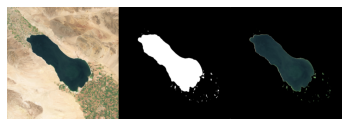

i= 131 loss= 0.14993801712989807 val_loss= 0.13792282342910767 mean_iou= 0.7616978 val_mean_iou= 0.76946527
250.3264


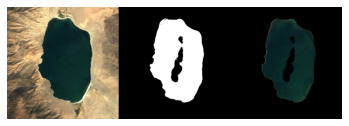

i= 132 loss= 0.2638392448425293 val_loss= 0.16664917767047882 mean_iou= 0.49475285 val_mean_iou= 0.7052984
254.99963


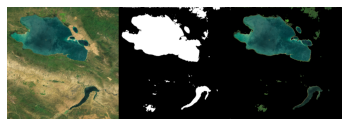

i= 133 loss= 0.2785755693912506 val_loss= 0.12649837136268616 mean_iou= 0.47825167 val_mean_iou= 0.7729677
254.99962


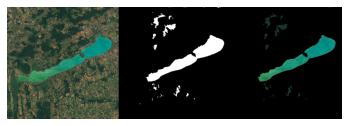

i= 134 loss= 0.12110021710395813 val_loss= 0.11957661807537079 mean_iou= 0.7689412 val_mean_iou= 0.78627914
82.55364


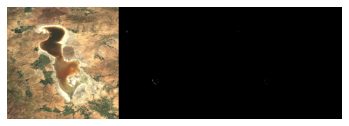

i= 135 loss= 0.08186940103769302 val_loss= 0.10685171186923981 mean_iou= 0.8473086 val_mean_iou= 0.8258012
254.99966


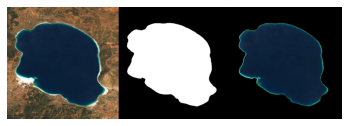

i= 136 loss= 0.08435606956481934 val_loss= 0.10916329175233841 mean_iou= 0.8179377 val_mean_iou= 0.8028437
253.35037


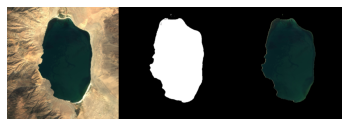

i= 137 loss= 0.08328527212142944 val_loss= 0.10681845992803574 mean_iou= 0.8208568 val_mean_iou= 0.7805287
254.99773


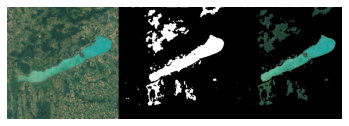

i= 138 loss= 0.08134602010250092 val_loss= 0.10664388537406921 mean_iou= 0.8848483 val_mean_iou= 0.7906609
253.42763


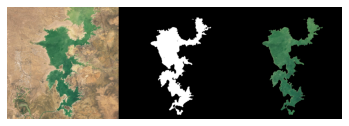

i= 139 loss= 0.06375811994075775 val_loss= 0.09777671843767166 mean_iou= 0.8964914 val_mean_iou= 0.8117273
254.99918


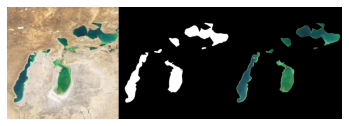

i= 140 loss= 0.05738730728626251 val_loss= 0.0917123556137085 mean_iou= 0.89761144 val_mean_iou= 0.80420315
252.58492


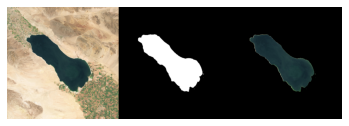

i= 141 loss= 0.0717584416270256 val_loss= 0.09886390715837479 mean_iou= 0.83187073 val_mean_iou= 0.80807006
254.99992


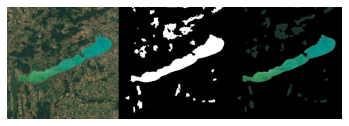

i= 142 loss= 0.07737646996974945 val_loss= 0.09302756935358047 mean_iou= 0.8421914 val_mean_iou= 0.8056559
254.83768


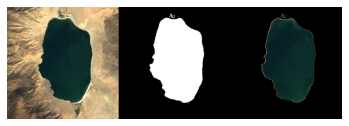

i= 143 loss= 0.057115040719509125 val_loss= 0.10045645385980606 mean_iou= 0.9101914 val_mean_iou= 0.8130239
254.99998


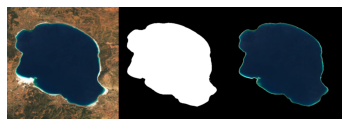

i= 144 loss= 0.06910677254199982 val_loss= 0.09628203511238098 mean_iou= 0.90959007 val_mean_iou= 0.7231587
254.3937


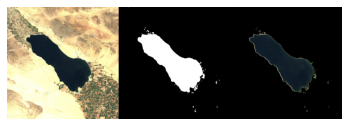

i= 145 loss= 0.08314692974090576 val_loss= 0.11214995384216309 mean_iou= 0.8042881 val_mean_iou= 0.71257013
254.96832


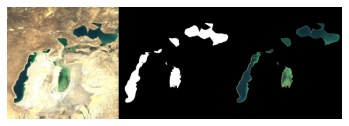

i= 146 loss= 0.07457789778709412 val_loss= 0.1074700653553009 mean_iou= 0.85882777 val_mean_iou= 0.7233254
255.0


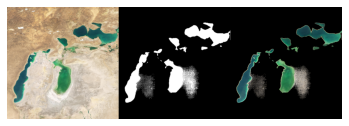

i= 147 loss= 0.07504904270172119 val_loss= 0.10231814533472061 mean_iou= 0.8261388 val_mean_iou= 0.76748997
254.592


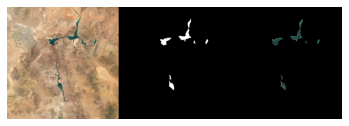

i= 148 loss= 0.07740582525730133 val_loss= 0.09080515801906586 mean_iou= 0.88156736 val_mean_iou= 0.7706967
149.14551


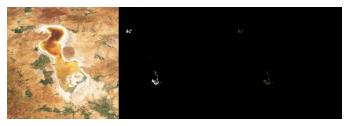

i= 149 loss= 0.07311039417982101 val_loss= 0.061305221170186996 mean_iou= 0.86846316 val_mean_iou= 0.8569943
254.99959


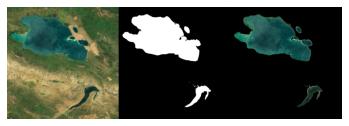

i= 150 loss= 0.06648436933755875 val_loss= 0.05773982033133507 mean_iou= 0.8836471 val_mean_iou= 0.858027
165.13684


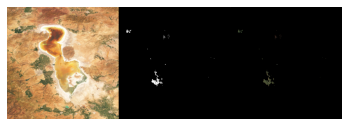

i= 151 loss= 0.04021850973367691 val_loss= 0.05387415736913681 mean_iou= 0.90812343 val_mean_iou= 0.85572004
255.0


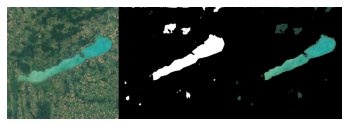

i= 152 loss= 0.060773395001888275 val_loss= 0.06770528107881546 mean_iou= 0.88448596 val_mean_iou= 0.8379364
254.76451


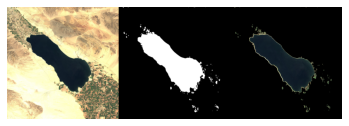

i= 153 loss= 0.058274827897548676 val_loss= 0.07806869596242905 mean_iou= 0.92604184 val_mean_iou= 0.8074749
254.93217


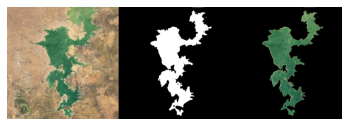

i= 154 loss= 0.07939771562814713 val_loss= 0.0721970796585083 mean_iou= 0.82816756 val_mean_iou= 0.83881223
255.0


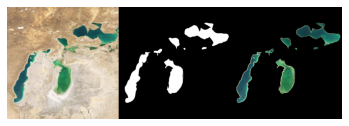

i= 155 loss= 0.05408409982919693 val_loss= 0.07736314088106155 mean_iou= 0.8869615 val_mean_iou= 0.85226583
254.95233


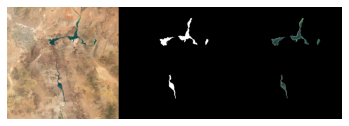

i= 156 loss= 0.027286017313599586 val_loss= 0.09316901117563248 mean_iou= 0.9515564 val_mean_iou= 0.84266096
254.99982


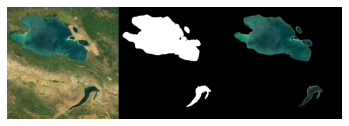

i= 157 loss= 0.06337983906269073 val_loss= 0.12331879884004593 mean_iou= 0.8933146 val_mean_iou= 0.76659995
254.99739


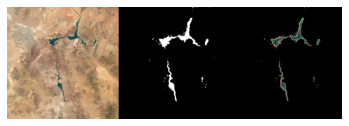

i= 158 loss= 0.0999903753399849 val_loss= 0.12670940160751343 mean_iou= 0.8512217 val_mean_iou= 0.8340858
252.60474


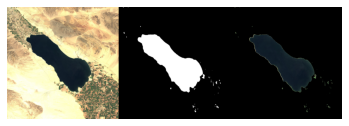

i= 159 loss= 0.07755013555288315 val_loss= 0.17284135520458221 mean_iou= 0.8927019 val_mean_iou= 0.7857949
254.99866


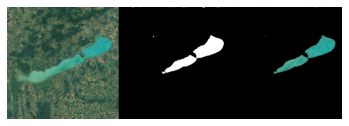

i= 160 loss= 0.1475944221019745 val_loss= 0.18909624218940735 mean_iou= 0.7257475 val_mean_iou= 0.7328488
254.99944


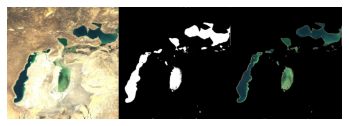

i= 161 loss= 0.14530757069587708 val_loss= 0.13095210492610931 mean_iou= 0.80336833 val_mean_iou= 0.8409385
253.14778


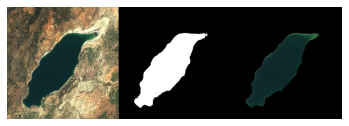

i= 162 loss= 0.08415837585926056 val_loss= 0.1189853847026825 mean_iou= 0.8702413 val_mean_iou= 0.8460664
253.98811


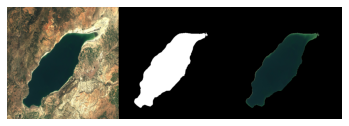

i= 163 loss= 0.07793641090393066 val_loss= 0.11370833218097687 mean_iou= 0.8377925 val_mean_iou= 0.8172349
250.43259


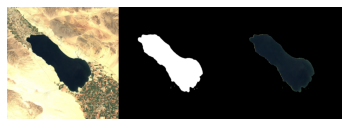

i= 164 loss= 0.06255416572093964 val_loss= 0.10522182285785675 mean_iou= 0.8585628 val_mean_iou= 0.83713573
254.72913


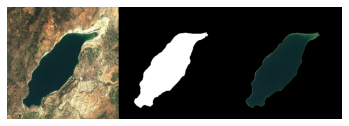

i= 165 loss= 0.04792718216776848 val_loss= 0.10092638432979584 mean_iou= 0.91225815 val_mean_iou= 0.8326392
254.1782


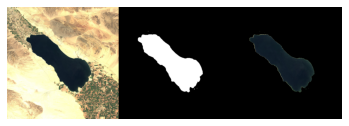

i= 166 loss= 0.041932981461286545 val_loss= 0.09742676466703415 mean_iou= 0.9418168 val_mean_iou= 0.840489
138.10474


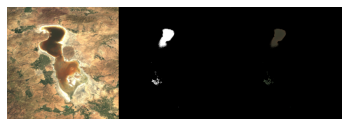

i= 167 loss= 0.05372856557369232 val_loss= 0.0796414241194725 mean_iou= 0.87139714 val_mean_iou= 0.88236415
254.97589


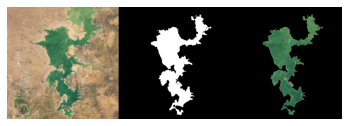

i= 168 loss= 0.03999469429254532 val_loss= 0.06741910427808762 mean_iou= 0.9102904 val_mean_iou= 0.90075237
154.83589


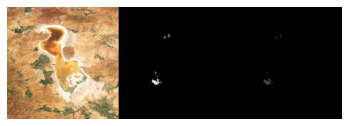

i= 169 loss= 0.043229639530181885 val_loss= 0.06697551906108856 mean_iou= 0.9411868 val_mean_iou= 0.9035262
254.99997


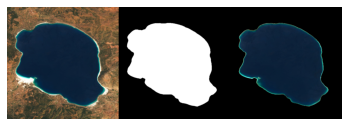

i= 170 loss= 0.06681348383426666 val_loss= 0.11241891235113144 mean_iou= 0.84303683 val_mean_iou= 0.7864
255.0


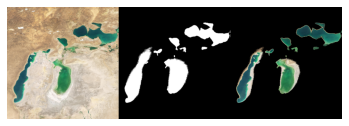

i= 171 loss= 0.09311313927173615 val_loss= 0.14303240180015564 mean_iou= 0.78895986 val_mean_iou= 0.8082324
82.442184


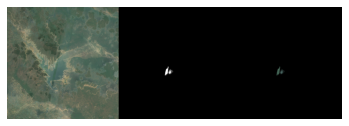

i= 172 loss= 0.18727588653564453 val_loss= 0.23494389653205872 mean_iou= 0.69246113 val_mean_iou= 0.66416496
253.80121


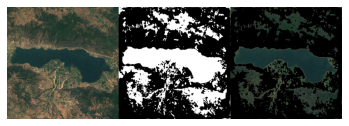

i= 173 loss= 0.23278535902500153 val_loss= 0.10237608104944229 mean_iou= 0.66490304 val_mean_iou= 0.8597551
254.99847


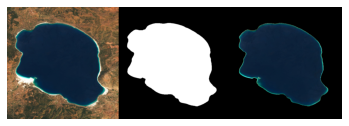

i= 174 loss= 0.07659759372472763 val_loss= 0.08910977095365524 mean_iou= 0.8746901 val_mean_iou= 0.8418322
254.19438


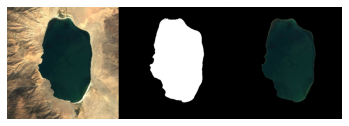

i= 175 loss= 0.06195734441280365 val_loss= 0.08037728816270828 mean_iou= 0.9061005 val_mean_iou= 0.8487508
254.99939


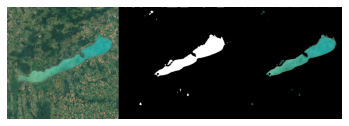

i= 176 loss= 0.09252149611711502 val_loss= 0.06605386734008789 mean_iou= 0.8782995 val_mean_iou= 0.8618538
254.99982


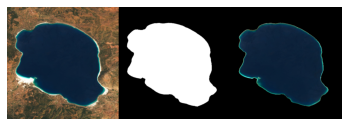

i= 177 loss= 0.06249580904841423 val_loss= 0.05705670267343521 mean_iou= 0.8970157 val_mean_iou= 0.8448708
255.0


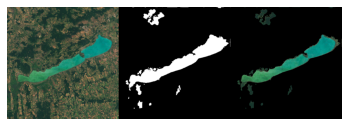

i= 178 loss= 0.038804709911346436 val_loss= 0.054034892469644547 mean_iou= 0.92445266 val_mean_iou= 0.864655
254.99997


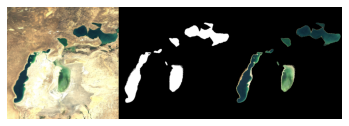

i= 179 loss= 0.050658468157052994 val_loss= 0.04960063472390175 mean_iou= 0.8929974 val_mean_iou= 0.88148165
254.99757


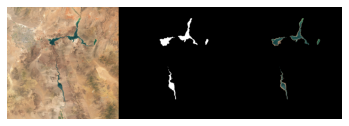

i= 180 loss= 0.05416599661111832 val_loss= 0.07307172566652298 mean_iou= 0.927628 val_mean_iou= 0.8196886
254.99973


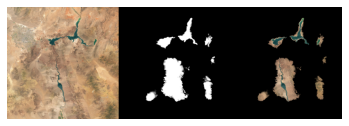

i= 181 loss= 0.060534678399562836 val_loss= 0.08490969240665436 mean_iou= 0.8924578 val_mean_iou= 0.87192154
253.83163


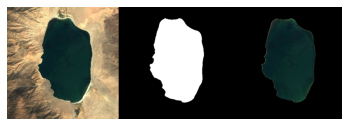

i= 182 loss= 0.07872471213340759 val_loss= 0.11122345179319382 mean_iou= 0.836719 val_mean_iou= 0.8596464
254.99669


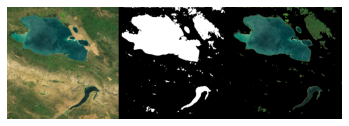

i= 183 loss= 0.11840476840734482 val_loss= 0.0956604927778244 mean_iou= 0.76584595 val_mean_iou= 0.82699955
251.52774


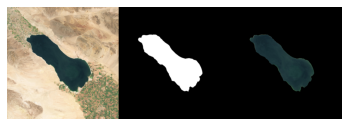

i= 184 loss= 0.11597279459238052 val_loss= 0.0932874009013176 mean_iou= 0.79002905 val_mean_iou= 0.8516947
172.60431


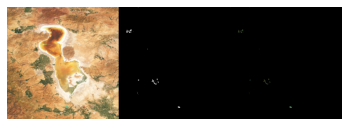

i= 185 loss= 0.15373650193214417 val_loss= 0.6831654906272888 mean_iou= 0.7575323 val_mean_iou= 0.37738663
100.83479


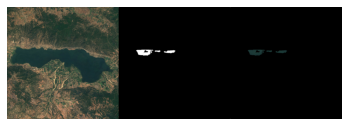

i= 186 loss= 0.7649584412574768 val_loss= 0.1213960349559784 mean_iou= 0.47083467 val_mean_iou= 0.78172547
114.95124


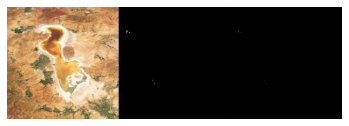

i= 187 loss= 0.08207400143146515 val_loss= 0.07278967648744583 mean_iou= 0.85663635 val_mean_iou= 0.8923305
250.54076


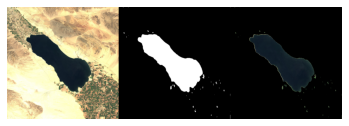

i= 188 loss= 0.06319249421358109 val_loss= 0.08098912984132767 mean_iou= 0.9427663 val_mean_iou= 0.8645028
254.99843


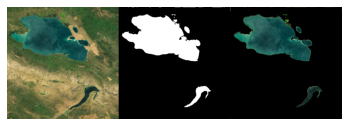

i= 189 loss= 0.10230796039104462 val_loss= 0.0898381769657135 mean_iou= 0.8470996 val_mean_iou= 0.8137581
254.1884


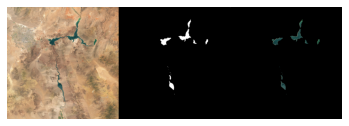

i= 190 loss= 0.06489524990320206 val_loss= 0.07984364032745361 mean_iou= 0.8971074 val_mean_iou= 0.8429646
254.73949


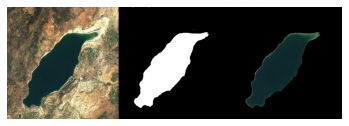

i= 191 loss= 0.09825228154659271 val_loss= 0.08638302981853485 mean_iou= 0.8194754 val_mean_iou= 0.81695175
254.98523


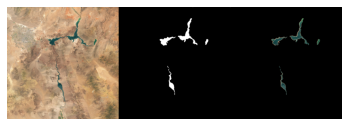

i= 192 loss= 0.0642477422952652 val_loss= 0.1355598121881485 mean_iou= 0.8847096 val_mean_iou= 0.76335734
254.3367


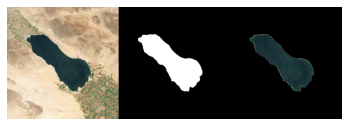

i= 193 loss= 0.09172958880662918 val_loss= 0.10246893763542175 mean_iou= 0.8113544 val_mean_iou= 0.7838811
251.96838


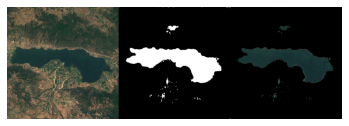

i= 194 loss= 0.06273870170116425 val_loss= 0.10045808553695679 mean_iou= 0.9057822 val_mean_iou= 0.7798728
254.99658


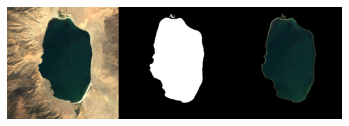

i= 195 loss= 0.05616047605872154 val_loss= 0.09909616410732269 mean_iou= 0.9131632 val_mean_iou= 0.75915045
254.99957


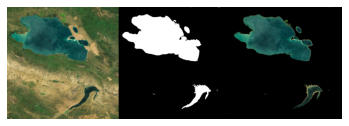

i= 196 loss= 0.06008223444223404 val_loss= 0.09545222669839859 mean_iou= 0.9188471 val_mean_iou= 0.75388134
255.0


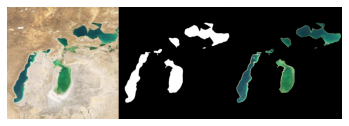

i= 197 loss= 0.05633975937962532 val_loss= 0.1162712499499321 mean_iou= 0.86811984 val_mean_iou= 0.7135261
253.512


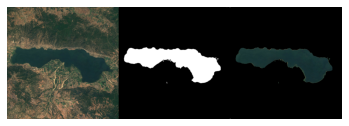

i= 198 loss= 0.06947513669729233 val_loss= 0.12574650347232819 mean_iou= 0.8620983 val_mean_iou= 0.6843014
250.8294


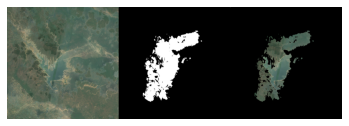

i= 199 loss= 0.05571649968624115 val_loss= 0.20360802114009857 mean_iou= 0.9104754 val_mean_iou= 0.69401526
252.22731


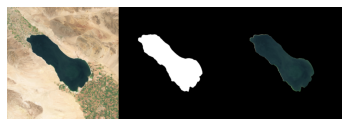

i= 200 loss= 0.09761035442352295 val_loss= 0.15344321727752686 mean_iou= 0.8957661 val_mean_iou= 0.64584935
217.4072


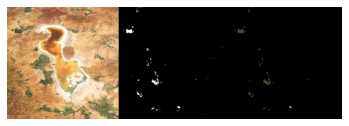

In [24]:
history_aug = model.fit_generator(train_generator, 
                    epochs = 200, steps_per_epoch = train_steps,
                    validation_data = test_generator, validation_steps = test_steps,
                    callbacks = build_callbacks(), verbose = 0,
                    use_multiprocessing=True)

In [26]:
#history.model.save_weights("history.model")
#history_aug.model.save_weights("history_aug.model")

<table style="font-size: 1em; padding: 0; margin: 0;">

<h1 style="width: 100%; text-align: left; padding: 0px 25px;"><small style="color: #182AEB;">
    </small><br/>Evaluating <br/> semantic segmentation results</h1>
<br/>
<p style="border-left: 15px solid #182AEB; text-align:justify; padding: 0 10px;">
We evaluate how good a model is at prediction using an unseen test set of images and an evaluation metric. 
</p>
        </tr>
        </table>

#### Examine training history

`history` contains the training and validation metrics that we can then plot as a function of epoch

`history_aug` is the equivalent for the second set of training using augmented data. 

We have both training and validation losses and mean IoU scores:

In [27]:
print(history.history.keys())

dict_keys(['loss', 'mean_iou', 'val_loss', 'val_mean_iou'])


In [28]:
print(history_aug.history.keys())

dict_keys(['loss', 'mean_iou', 'val_loss', 'val_mean_iou'])


The plot below shows the training history of the original non-augmented and augmented training runs. You can see by comparing the four curves that augmentation doesn't helps a little with overall final training accuracy, which seems to start to plateau at around 0.85 for both augmented models. Augmentation also seemsto help the model generalize better; test set scores are generally higher at around 0.7

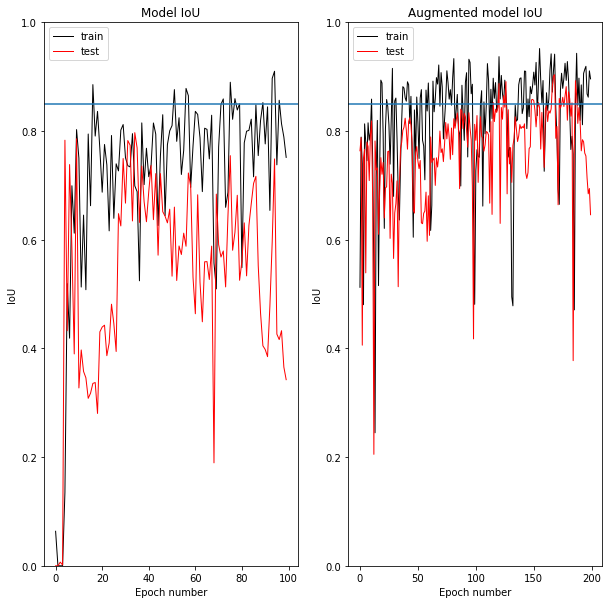

In [29]:
# summarize history for iou
plt.figure(figsize=(10,10))
plt.subplot(121)
plt.plot(history.history['mean_iou'],'k',lw=1) #plot the training iou curve
plt.plot(history.history['val_mean_iou'],'r',lw=1) #plot the testing iou curve
plt.ylim(0,1) #put limits of y axis
plt.axhline(y=0.85) #draw a horizontal line at 85% IoU
plt.title('Model IoU') #add title, labels and a legend
plt.ylabel('IoU')
plt.xlabel('Epoch number')
plt.legend(['train', 'test'], loc='upper left')

plt.subplot(122)
plt.plot(history_aug.history['mean_iou'],'k',lw=1)
plt.plot(history_aug.history['val_mean_iou'],'r',lw=1)
plt.title('Augmented model IoU')
plt.ylim(0,1)
plt.axhline(y=0.85)
plt.ylabel('IoU')
plt.xlabel('Epoch number')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

Augmentation improves IoU too, approaching the 5% error line

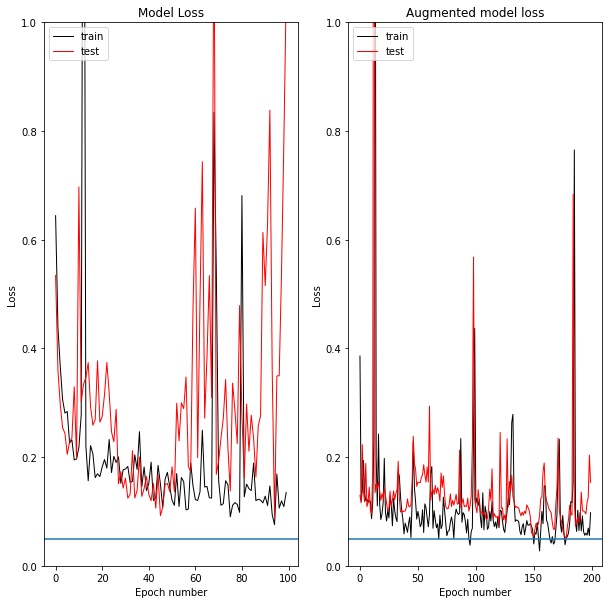

In [30]:
plt.figure(figsize=(10,10))
plt.subplot(121)
plt.plot(history.history['loss'],'k',lw=1)
plt.plot(history.history['val_loss'],'r',lw=1)
plt.ylim(0,1)
plt.axhline(y=0.05)
plt.title('Model Loss')
plt.ylabel('Loss')
plt.xlabel('Epoch number')
plt.legend(['train', 'test'], loc='upper left')

plt.subplot(122)
plt.plot(history_aug.history['loss'],'k',lw=1)
plt.plot(history_aug.history['val_loss'],'r',lw=1)
plt.title('Augmented model loss')
plt.ylim(0,1)
plt.axhline(y=0.05)
plt.ylabel('Loss')
plt.xlabel('Epoch number')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

#### Testing

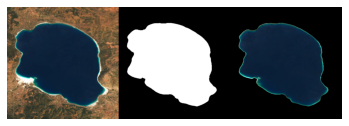

In [31]:
# open an image 
raw = Image.open('s2cloudless_imagery'+os.sep+'data'+os.sep+test_files[0])

# resize and rescale, which is what the model is expecting as inputs
raw = np.array(raw.resize((512, 512)))/255.
##raw = raw[:,:,0:3]

#predict the mask 
pred = model.predict(np.expand_dims(raw, 0))

#mask post-processing 
msk  = pred.squeeze()
msk = np.stack((msk,)*3, axis=-1)
# binarize
msk[msk >= 0.5] = 1 
msk[msk < 0.5] = 0 

#show the mask and the segmented image 
combined = np.concatenate([raw, msk, raw* msk], axis = 1)
plt.axis('off')
plt.imshow(combined)
plt.show()

What next?

It did _reasonably_ well on the training data but not so well. We probably need more data. This is where the NWPU-RESISC45 imagery might come to the rescue!

![](https://github.com/dbuscombe-usgs/cdi_dl_workshop/raw/67e8c84d0e0b89b024814ef2e8f3bed091ee0c4e/Day2/figs/Picture1.png)

<table style="font-size: 1em; padding: 0; margin: 0;">
<p style="border: 1px solid #ff5733; border-left: 15px solid #ff5733; padding: 10px; text-align:justify;">
    <strong style="color: #ff5733">Deliverable</strong>  
    <br/>The deliverable for Part 4 is a jupyter notebook showing a workflow to train and test U-Net models for training using augmented NWPU-RESISC45 lake images and corresponding labels, and using augmented sentinel-2 cloudless imagery and corresponding labels. So, there are two U-Net based models in total. You should compare their outputs. Finally, you should test the model trained on NWPU imagery on the s2cloudless imagery.  This will mostly test your understanding of the generic yet complex workflow of training, testing and comparing models based on a test data set, as well as how to interpret evaluation metrics. The baseline evaluation of testing the model trained on NWPU imagery on the s2cloudless imagery (in machine learning called "transfer learning") is what you will optimize in Part 5.
    </p>

Like Part 3, below are some convenience functions for those working on Google Colab with a GPU runtime

In [32]:
#colab = 0
colab = 1

if colab==1:
    %tensorflow_version 2.x
    !pip install --default-timeout=1000 tensorflow-gpu==2.0   

In [33]:
%tensorflow_version 2.x

After restarting your runtime, make sure you have access to a GPU with Tensorflow 2

In [34]:
import tensorflow as tf
print(tf.__version__)
print(tf.test.is_gpu_available())

2.0.0
True


Convenience functions if you need to download example (minimal) imagery sets derived from NWPU and Sentinel-2 cloudless:

In [35]:
# from https://stackoverflow.com/questions/38511444/python-download-files-from-google-drive-using-url
import requests

def download_file_from_google_drive(id, destination):
    URL = "https://docs.google.com/uc?export=download"

    session = requests.Session()

    response = session.get(URL, params = { 'id' : id }, stream = True)
    token = get_confirm_token(response)

    if token:
        params = { 'id' : id, 'confirm' : token }
        response = session.get(URL, params = params, stream = True)

    save_response_content(response, destination)    

def get_confirm_token(response):
    for key, value in response.cookies.items():
        if key.startswith('download_warning'):
            return value

    return None

def save_response_content(response, destination):
    CHUNK_SIZE = 32768

    with open(destination, "wb") as f:
        for chunk in response.iter_content(CHUNK_SIZE):
            if chunk: # filter out keep-alive new chunks
                f.write(chunk)


#s2 cloudless imagery
file_id = '1iMfIjr_ul49Ghs2ewazjCt8HMPfhY47h'
destination = 's2cloudless_imagery.zip'
if colab==1:
    download_file_from_google_drive(file_id, destination)

#s2 cloudless labels
file_id = '1c7MpwKVejoUuW9F2UaF_vps8Vq2RZRfR'
destination = 's2cloudless_label_imagery.zip'
if colab==1:
    download_file_from_google_drive(file_id, destination)


#nwpu imagery
file_id = '1gtuqy1VlU8-M5IEMnmiSuTlI5PxQPnGB'
destination = 'nwpu_images.zip'
if colab==1:
    download_file_from_google_drive(file_id, destination)

#nwpu labels
file_id = '1W5LGbcYAcFbG5YjLgX_ekBn0u5Rno35x'
destination = 'nwpu_label_images.zip'
if colab==1:
    download_file_from_google_drive(file_id, destination)     

In [36]:
import zipfile
def unzip(f):
    """
    f = file to be unzipped
    """    
    with zipfile.ZipFile(f, 'r') as zip_ref:
        zip_ref.extractall()
        
if colab==1:
    #unzip('s2cloudless_imagery.zip')
    #unzip('s2cloudless_label_imagery.zip')   
    unzip('nwpu_images.zip')
    unzip('nwpu_label_images.zip')       

#### Setting up the model

We'll pick up from the end of the Part 3 deliverable, where you should have test and train generator functions and hyperparameters set.

You should have augmented images and associated labels for both sentinel2-cloudless and NWPU data

Define the IOU function and Unet model:

In [37]:
%matplotlib inline
import tensorflow as tf
from tensorflow.keras.layers import Input, Conv2D, MaxPooling2D, UpSampling2D
from tensorflow.keras.layers import Concatenate, Conv2DTranspose
from tensorflow.keras.models import Model
import numpy as np
import json, os
from random import shuffle
from PIL import Image
import matplotlib
import matplotlib.pyplot as plt

In [38]:
def mean_iou(y_true, y_pred):
    yt0 = y_true[:,:,:,0]
    yp0 = tf.keras.backend.cast(y_pred[:,:,:,0] > 0.5, 'float32')
    inter = tf.math.count_nonzero(tf.logical_and(tf.equal(yt0, 1), tf.equal(yp0, 1)))
    union = tf.math.count_nonzero(tf.add(yt0, yp0))
    iou = tf.where(tf.equal(union, 0), 1., tf.cast(inter/union, 'float32'))
    return iou

def unet(sz = (512, 512, 3)):
    inputs = Input(sz)
    _ = inputs
  
    #down sampling 
    f = 8
    layers = []
  
    for i in range(0, 6):
      _ = Conv2D(f, 3, activation='relu', padding='same') (_)
      _ = Conv2D(f, 3, activation='relu', padding='same') (_)
      layers.append(_)
      _ = MaxPooling2D() (_)
      f = f*2
    ff2 = 64 
  
    #bottleneck 
    j = len(layers) - 1
    _ = Conv2D(f, 3, activation='relu', padding='same') (_)
    _ = Conv2D(f, 3, activation='relu', padding='same') (_)
    _ = Conv2DTranspose(ff2, 2, strides=(2, 2), padding='same') (_)
    _ = Concatenate(axis=3)([_, layers[j]])
    j = j -1 
  
    #upsampling 
    for i in range(0, 5):
      ff2 = ff2//2
      f = f // 2 
      _ = Conv2D(f, 3, activation='relu', padding='same') (_)
      _ = Conv2D(f, 3, activation='relu', padding='same') (_)
      _ = Conv2DTranspose(ff2, 2, strides=(2, 2), padding='same') (_)
      _ = Concatenate(axis=3)([_, layers[j]])
      j = j -1 
    
    #classification 
    _ = Conv2D(f, 3, activation='relu', padding='same') (_)
    _ = Conv2D(f, 3, activation='relu', padding='same') (_)
    outputs = Conv2D(1, 1, activation='sigmoid') (_)
  
    #model creation 
    model = Model(inputs=[inputs], outputs=[outputs])
    model.compile(optimizer = 'rmsprop', loss = 'binary_crossentropy', metrics = [mean_iou])
  
    return model  


model = unet()

Create the class for training process plot, like shown in Part 4. One for each dataset. First, the augmented NWPU imagery

In [39]:
class PlotLearningNWPU(tf.keras.callbacks.Callback):

    def on_train_begin(self, logs={}):
        self.i = 0
        self.x = []
        self.losses = []
        self.val_losses = []
        self.acc = []
        self.val_acc = []
        self.logs = []
    def on_epoch_end(self, epoch, logs={}):
        self.logs.append(logs)
        self.x.append(self.i)
        self.losses.append(logs.get('loss'))
        self.val_losses.append(logs.get('val_loss'))
        self.acc.append(logs.get('mean_iou'))
        self.val_acc.append(logs.get('val_mean_iou'))
        self.i += 1
        print('i=',self.i,'loss=',logs.get('loss'),'val_loss=',logs.get('val_loss'),'mean_iou=',logs.get('mean_iou'),'val_mean_iou=',logs.get('val_mean_iou'))
        
        #choose a random test image and preprocess
        path = np.random.choice(test_filesNWPU)
        infile = f'nwpu_images/data/{path}'
        raw = Image.open(infile)
        raw = np.array(raw.resize((512, 512)))/255.
        raw = raw[:,:,0:3]
        
        #predict the mask 
        pred = 255*model.predict(np.expand_dims(raw, 0)).squeeze()
        print(np.max(pred))
                
        #mask post-processing 
        msk  = (pred>60).astype('int') #100       
        msk = np.stack((msk,)*3, axis=-1)
        
        #show the mask and the segmented image 
        combined = np.concatenate([raw, msk, raw* msk], axis = 1)
        plt.axis('off')
        plt.imshow(combined)
        plt.show()

def build_callbacksNWPU():
        checkpointer = tf.keras.callbacks.ModelCheckpoint(filepath='nwpu_unet.h5', verbose=0, save_best_only=True, save_weights_only=True)
        callbacks = [checkpointer, PlotLearningNWPU()]
        return callbacks

and a separate one for the S2 imagery

In [40]:
class PlotLearningS2(tf.keras.callbacks.Callback):

    def on_train_begin(self, logs={}):
        self.i = 0
        self.x = []
        self.losses = []
        self.val_losses = []
        self.acc = []
        self.val_acc = []
        self.logs = []
    def on_epoch_end(self, epoch, logs={}):
        self.logs.append(logs)
        self.x.append(self.i)
        self.losses.append(logs.get('loss'))
        self.val_losses.append(logs.get('val_loss'))
        self.acc.append(logs.get('mean_iou'))
        self.val_acc.append(logs.get('val_mean_iou'))
        self.i += 1
        print('i=',self.i,'loss=',logs.get('loss'),'val_loss=',logs.get('val_loss'),'mean_iou=',logs.get('mean_iou'),'val_mean_iou=',logs.get('val_mean_iou'))
        
        #choose a random test image and preprocess
        path = np.random.choice(test_filesS2)
        infile = f's2cloudless_imagery/data/{path}'
        raw = Image.open(infile)
        raw = np.array(raw.resize((512, 512)))/255.
        raw = raw[:,:,0:3]
        
        #predict the mask 
        pred = 255*model.predict(np.expand_dims(raw, 0)).squeeze()
        print(np.max(pred))
                
        #mask post-processing 
        msk  = (pred>60).astype('int') #100       
        msk = np.stack((msk,)*3, axis=-1)
        
        #show the mask and the segmented image 
        combined = np.concatenate([raw, msk, raw* msk], axis = 1)
        plt.axis('off')
        plt.imshow(combined)
        plt.show()

def build_callbacksS2():
        checkpointer = tf.keras.callbacks.ModelCheckpoint(filepath='s2cloudless_unet.h5', verbose=0, save_best_only=True, save_weights_only=True)
        callbacks = [checkpointer, PlotLearningS2()]
        return callbacks

Define image generator files for each data set

In [41]:
def image_batch_generatorS2(files, batch_size = 32, sz = (512, 512)):
  
  while True: # this is here because it will be called repeatedly by the training function
    
    #extract a random subset of files of length "batch_size"
    batch = np.random.choice(files, size = batch_size)    
    
    #variables for collecting batches of inputs (x) and outputs (y)
    batch_x = []
    batch_y = []
    
    #cycle through each image in the batch
    for f in batch:

        #preprocess the raw images 
        rawfile = f's2cloudless_imagery/data/{f}'
        raw = Image.open(rawfile)
        raw = raw.resize(sz)
        raw = np.array(raw)

        #check the number of channels because some of the images are RGBA or GRAY
        if len(raw.shape) == 2:
            raw = np.stack((raw,)*3, axis=-1)

        else:
            raw = raw[:,:,0:3]
            
        #get the image dimensions, find the min dimension, then square the image off    
        nx, ny, nz = np.shape(raw)
        n = np.minimum(nx,ny)
        raw = raw[:n,:n,:] 
            
        batch_x.append(raw)
        
        #get the masks. 
        maskfile = rawfile.replace('s2cloudless_imagery','s2cloudless_label_imagery')+'_mask.jpg'
        mask = Image.open(maskfile)
        # the mask is 3-dimensional so get the max in each channel to flatten to 2D
        mask = np.max(np.array(mask.resize(sz)),axis=2)
        # water pixels are always greater than 100
        mask = (mask>100).astype('int')
        
        mask = mask[:n,:n]

        batch_y.append(mask)

    #preprocess a batch of images and masks 
    batch_x = np.array(batch_x)/255. #divide image by 255 to normalize
    batch_y = np.array(batch_y)
    batch_y = np.expand_dims(batch_y,3) #add singleton dimension to batch_y

    yield (batch_x, batch_y) #yield both the image and the label together

In [42]:
def image_batch_generatorNWPU(files, batch_size = 32, sz = (512, 512)):
  
  while True: # this is here because it will be called repeatedly by the training function
    
    #extract a random subset of files of length "batch_size"
    batch = np.random.choice(files, size = batch_size)    
    
    #variables for collecting batches of inputs (x) and outputs (y)
    batch_x = []
    batch_y = []
    
    #cycle through each image in the batch
    for f in batch:

        #preprocess the raw images 
        rawfile = f'nwpu_images/data/{f}'
        raw = Image.open(rawfile)
        raw = raw.resize(sz)
        raw = np.array(raw)

        #check the number of channels because some of the images are RGBA or GRAY
        if len(raw.shape) == 2:
            raw = np.stack((raw,)*3, axis=-1)

        else:
            raw = raw[:,:,0:3]
            
        #get the image dimensions, find the min dimension, then square the image off    
        nx, ny, nz = np.shape(raw)
        n = np.minimum(nx,ny)
        raw = raw[:n,:n,:] 
            
        batch_x.append(raw)
        
        #get the masks. 
        maskfile = rawfile.replace('nwpu_images','nwpu_label_images')+'_mask.jpg'
        mask = Image.open(maskfile)
        # the mask is 3-dimensional so get the max in each channel to flatten to 2D
        mask = np.max(np.array(mask.resize(sz)),axis=2)
        # water pixels are always greater than 100
        mask = (mask>200).astype('int')
        
        mask = mask[:n,:n]

        batch_y.append(mask)

    #preprocess a batch of images and masks 
    batch_x = np.array(batch_x)/255. #divide image by 255 to normalize
    batch_y = np.array(batch_y)
    batch_y = np.expand_dims(batch_y,3) #add singleton dimension to batch_y

    yield (batch_x, batch_y) #yield both the image and the label together

Create two models, one for each data set

In [43]:
modelNWPU = unet()
modelS2 = unet()

In [44]:
batch_size = 8

prop_train = 0.6

#### Sentinel2-cloudless ("S2") imagery

Define the test and train steps like in Part 4 and run the model training

In [45]:
all_files = os.listdir('s2cloudless_imagery/data')
shuffle(all_files)

split = int(prop_train * len(all_files))

#split into training and testing
train_filesS2 = all_files[0:split]
test_filesS2  = all_files[split:]

train_stepsS2 = len(train_filesS2) //batch_size
test_stepsS2 = len(test_filesS2) //batch_size

print(train_stepsS2)
print(test_stepsS2)

train_generatorS2 = image_batch_generatorS2(train_filesS2, batch_size = batch_size)
test_generatorS2  = image_batch_generatorS2(test_filesS2, batch_size = batch_size)

10
7


i= 1 loss= 0.5248994201421737 val_loss= 0.36366139565195355 mean_iou= 0.016398111 val_mean_iou= 0.0
121.40407


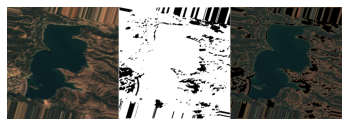

i= 2 loss= 0.32159960865974424 val_loss= 0.2655912382262094 mean_iou= 0.0 val_mean_iou= 8.677868e-07
122.92922


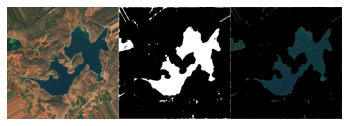

i= 3 loss= 0.2542015045881271 val_loss= 0.25007495284080505 mean_iou= 0.20817688 val_mean_iou= 0.07503927
110.21527


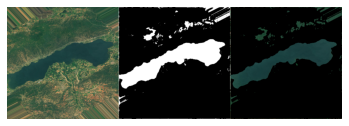

i= 4 loss= 0.2279830679297447 val_loss= 0.2235913404396602 mean_iou= 0.6159166 val_mean_iou= 0.7894071
111.16704


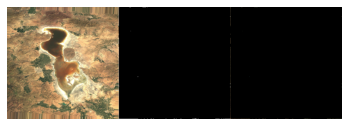

i= 5 loss= 0.2190782383084297 val_loss= 0.20486431675297873 mean_iou= 0.6084061 val_mean_iou= 0.8017572
196.06013


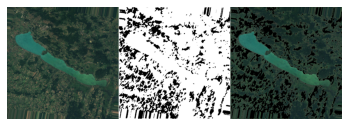

i= 6 loss= 0.20581476986408234 val_loss= 0.18514085667473928 mean_iou= 0.61006516 val_mean_iou= 0.8058366
214.08835


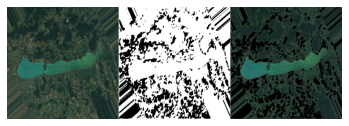

i= 7 loss= 0.21145367249846458 val_loss= 0.1804992769445692 mean_iou= 0.6795653 val_mean_iou= 0.7738431
164.92421


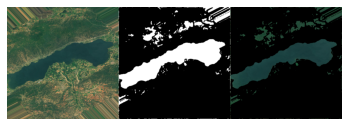

i= 8 loss= 0.22669281512498857 val_loss= 0.1853118453707014 mean_iou= 0.56969285 val_mean_iou= 0.73930687
204.73302


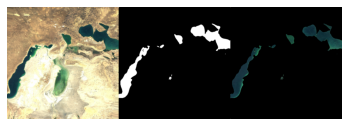

i= 9 loss= 0.18981734961271285 val_loss= 0.17327373794146947 mean_iou= 0.6900772 val_mean_iou= 0.77534
250.28142


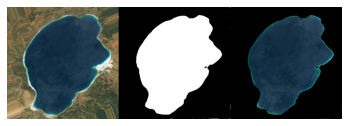

i= 10 loss= 0.23764095231890678 val_loss= 0.1837666013411113 mean_iou= 0.49682626 val_mean_iou= 0.787426
171.93799


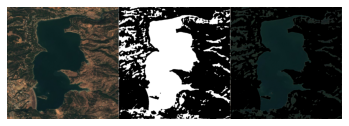

i= 11 loss= 0.2432875633239746 val_loss= 0.16285497375896998 mean_iou= 0.5644233 val_mean_iou= 0.80078655
90.512405


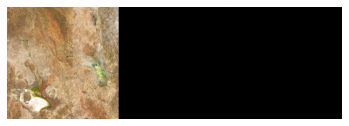

i= 12 loss= 0.22280798256397247 val_loss= 0.15768591314554214 mean_iou= 0.661731 val_mean_iou= 0.79413617
191.15877


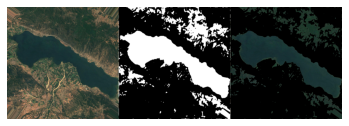

i= 13 loss= 0.156352998316288 val_loss= 0.14472682454756328 mean_iou= 0.7700283 val_mean_iou= 0.7878389
120.356064


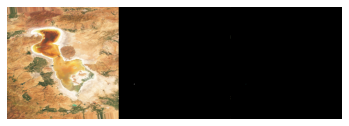

i= 14 loss= 0.42907610088586806 val_loss= 0.140883703316961 mean_iou= 0.6016364 val_mean_iou= 0.7632472
220.82004


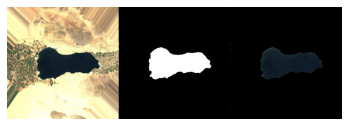

i= 15 loss= 0.3561756432056427 val_loss= 0.16979396768978663 mean_iou= 0.6478076 val_mean_iou= 0.65026134
223.86308


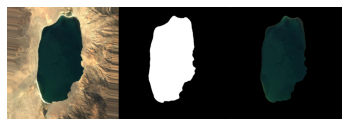

i= 16 loss= 0.17224287241697311 val_loss= 0.11634376219340734 mean_iou= 0.66984266 val_mean_iou= 0.84201247
142.45857


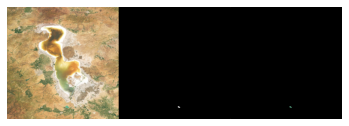

i= 17 loss= 0.26603284403681754 val_loss= 0.16442449603761947 mean_iou= 0.5290438 val_mean_iou= 0.8209023
232.23035


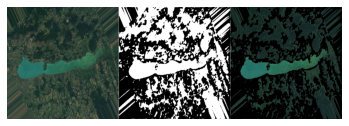

i= 18 loss= 0.16559985056519508 val_loss= 0.12225507093327385 mean_iou= 0.6810976 val_mean_iou= 0.87224704
251.45853


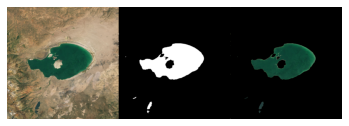

i= 19 loss= 0.23847096487879754 val_loss= 0.15689851556505477 mean_iou= 0.54567325 val_mean_iou= 0.74538416
202.39474


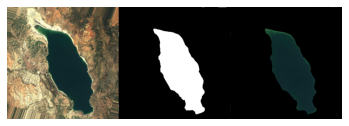

i= 20 loss= 0.19377695843577386 val_loss= 0.15589037111827306 mean_iou= 0.6267005 val_mean_iou= 0.70866543
241.19658


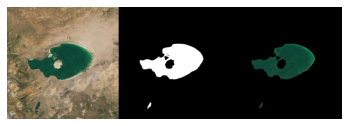

i= 21 loss= 0.15998675674200058 val_loss= 0.17409110920769827 mean_iou= 0.64730155 val_mean_iou= 0.7943099
94.45028


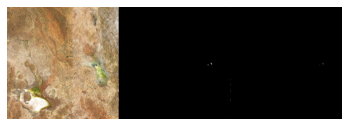

i= 22 loss= 0.14340090081095697 val_loss= 0.09322540249143328 mean_iou= 0.7600837 val_mean_iou= 0.86885303
242.61597


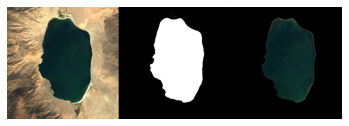

i= 23 loss= 0.17278887033462526 val_loss= 0.15232071174042566 mean_iou= 0.6968576 val_mean_iou= 0.78311336
250.55591


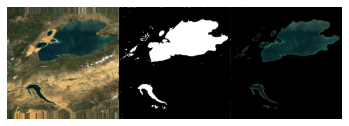

i= 24 loss= 0.17774427980184554 val_loss= 0.13552760226385935 mean_iou= 0.6595336 val_mean_iou= 0.75732756
72.12749


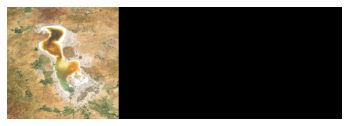

i= 25 loss= 0.12211398780345917 val_loss= 0.18670311995915004 mean_iou= 0.76108396 val_mean_iou= 0.7362533
254.97499


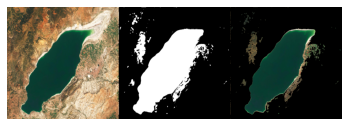

i= 26 loss= 0.14542018696665765 val_loss= 0.1593903633100646 mean_iou= 0.6677511 val_mean_iou= 0.7819125
247.18361


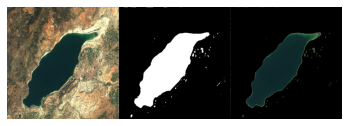

i= 27 loss= 0.19629805833101271 val_loss= 0.09361758721726281 mean_iou= 0.6094135 val_mean_iou= 0.87549406
232.81877


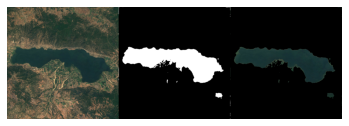

i= 28 loss= 0.16892171129584313 val_loss= 0.11197014153003693 mean_iou= 0.68341076 val_mean_iou= 0.8302768
254.26273


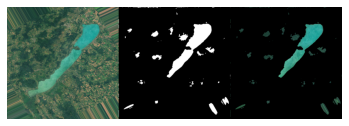

i= 29 loss= 0.10723872184753418 val_loss= 0.09200002838458333 mean_iou= 0.7957741 val_mean_iou= 0.87912816
95.39538


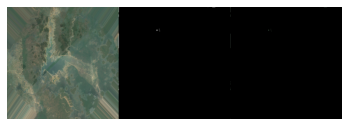

i= 30 loss= 0.1585145600140095 val_loss= 0.13429439600024903 mean_iou= 0.6768724 val_mean_iou= 0.71400106
239.08318


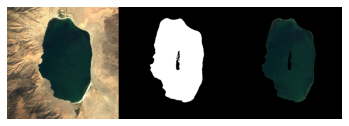

i= 31 loss= 0.09929253235459327 val_loss= 0.13922386190720967 mean_iou= 0.79522717 val_mean_iou= 0.7618071
253.69876


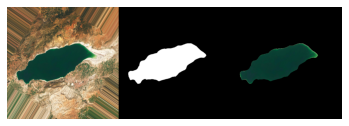

i= 32 loss= 0.3251934748142958 val_loss= 0.08943972630160195 mean_iou= 0.67041296 val_mean_iou= 0.87270844
240.87823


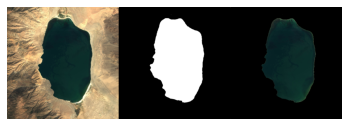

i= 33 loss= 0.11940533295273781 val_loss= 0.0929534477846963 mean_iou= 0.7482492 val_mean_iou= 0.8438974
222.9341


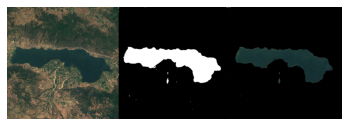

i= 34 loss= 0.10878971815109253 val_loss= 0.08977477039609637 mean_iou= 0.75601053 val_mean_iou= 0.8690124
253.65295


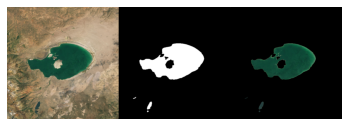

i= 35 loss= 0.0906207051128149 val_loss= 0.07676180292453084 mean_iou= 0.8067247 val_mean_iou= 0.87342435
240.18442


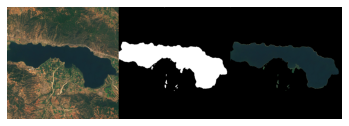

i= 36 loss= 0.1393282137811184 val_loss= 0.08043297380208969 mean_iou= 0.7585457 val_mean_iou= 0.8632832
252.66139


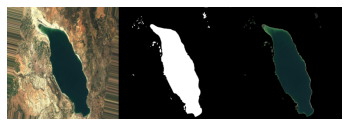

i= 37 loss= 0.0973831407725811 val_loss= 0.1176050848194531 mean_iou= 0.76483727 val_mean_iou= 0.8526265
248.98589


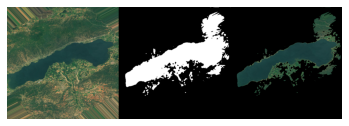

i= 38 loss= 0.13008154258131982 val_loss= 0.07289784774184227 mean_iou= 0.752991 val_mean_iou= 0.87503624
254.81776


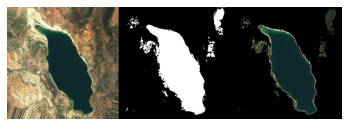

i= 39 loss= 0.13164384849369526 val_loss= 0.0903646286044802 mean_iou= 0.7696087 val_mean_iou= 0.85200936
254.97617


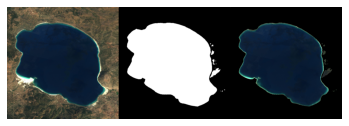

i= 40 loss= 0.10130670368671417 val_loss= 0.07356000265904836 mean_iou= 0.8248433 val_mean_iou= 0.8780948
248.68265


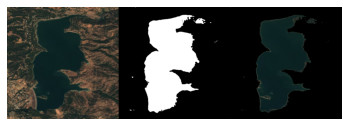

i= 41 loss= 0.13286083042621613 val_loss= 0.07515982325587954 mean_iou= 0.68746203 val_mean_iou= 0.86827713
254.97884


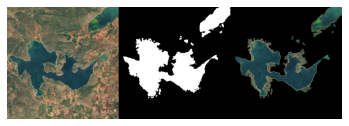

i= 42 loss= 0.07852291874587536 val_loss= 0.08888529134648186 mean_iou= 0.84214926 val_mean_iou= 0.82988894
245.20653


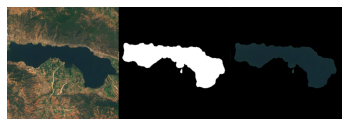

i= 43 loss= 0.13383216373622417 val_loss= 0.08438860837902341 mean_iou= 0.72868216 val_mean_iou= 0.8683928
252.32385


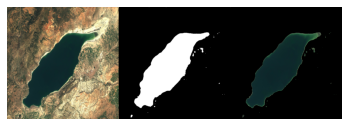

i= 44 loss= 0.08603613115847111 val_loss= 0.06341508935604777 mean_iou= 0.79549015 val_mean_iou= 0.87258595
254.93202


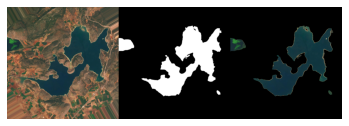

i= 45 loss= 0.16899820417165756 val_loss= 0.14553541157926833 mean_iou= 0.7534102 val_mean_iou= 0.77433395
254.9279


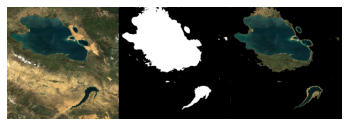

i= 46 loss= 0.10362906195223331 val_loss= 0.07211557190333094 mean_iou= 0.8142743 val_mean_iou= 0.85720116
90.05811


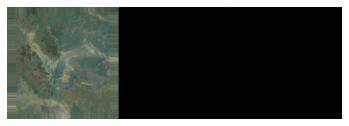

i= 47 loss= 0.06662036515772343 val_loss= 0.07629758811422757 mean_iou= 0.85319966 val_mean_iou= 0.8513342
254.99994


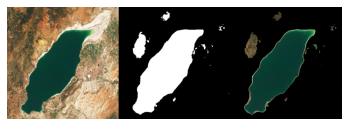

i= 48 loss= 0.18550091050565243 val_loss= 0.08322605916431972 mean_iou= 0.75627583 val_mean_iou= 0.8411765
252.80022


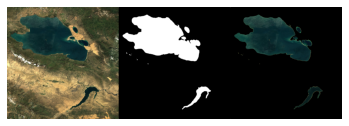

i= 49 loss= 0.08030738532543183 val_loss= 0.8657117400850568 mean_iou= 0.82146084 val_mean_iou= 0.45534235
254.10042


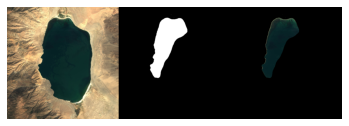

i= 50 loss= 0.16261252015829086 val_loss= 0.08905951199787003 mean_iou= 0.7339451 val_mean_iou= 0.8325307
253.78796


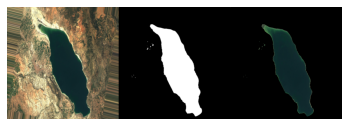

i= 51 loss= 0.1342407062649727 val_loss= 0.08919660161648478 mean_iou= 0.7288544 val_mean_iou= 0.82886505
254.41425


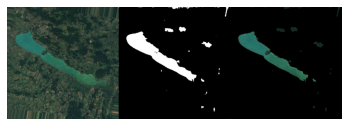

i= 52 loss= 0.08481313847005367 val_loss= 0.0925315496112619 mean_iou= 0.8210721 val_mean_iou= 0.8077913
254.86502


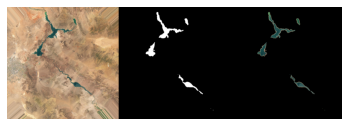

i= 53 loss= 0.12432536110281944 val_loss= 0.07361245793955666 mean_iou= 0.6991383 val_mean_iou= 0.8507648
254.92154


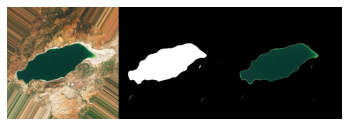

i= 54 loss= 0.05708900913596153 val_loss= 0.07549817806908063 mean_iou= 0.88862 val_mean_iou= 0.8504456
254.99951


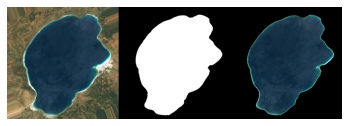

i= 55 loss= 0.09345862828195095 val_loss= 0.06419974139758519 mean_iou= 0.8139904 val_mean_iou= 0.86670107
254.96996


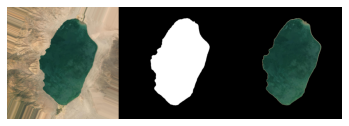

i= 56 loss= 0.11882377751171588 val_loss= 0.08597832332764353 mean_iou= 0.78697 val_mean_iou= 0.84702015
55.33112


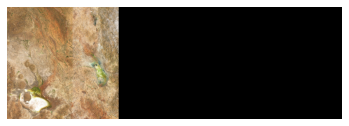

i= 57 loss= 0.06561219282448291 val_loss= 0.05412742069789341 mean_iou= 0.8286236 val_mean_iou= 0.8851195
254.99547


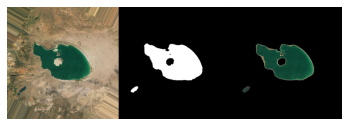

i= 58 loss= 0.12635909765958786 val_loss= 0.062596787831613 mean_iou= 0.74799156 val_mean_iou= 0.87023133
254.99773


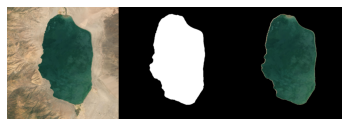

i= 59 loss= 0.08302839808166027 val_loss= 0.07475269426192556 mean_iou= 0.8506519 val_mean_iou= 0.83702123
254.08435


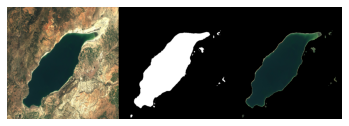

i= 60 loss= 0.06282250434160233 val_loss= 0.06485664950949806 mean_iou= 0.845506 val_mean_iou= 0.8522484
254.99298


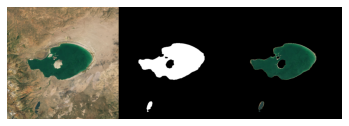

i= 61 loss= 0.10415853671729565 val_loss= 0.06701654089348656 mean_iou= 0.8203467 val_mean_iou= 0.85157293
253.71777


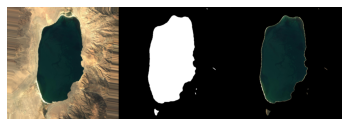

i= 62 loss= 0.12686602137982844 val_loss= 0.08381800779274531 mean_iou= 0.7046311 val_mean_iou= 0.7835577
146.88727


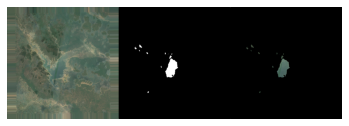

i= 63 loss= 0.056281708925962445 val_loss= 0.05732393477644239 mean_iou= 0.8748212 val_mean_iou= 0.87099457
254.82408


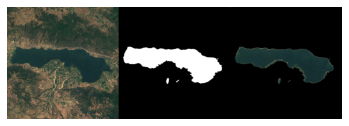

i= 64 loss= 0.06525796502828599 val_loss= 0.052693674873028486 mean_iou= 0.84604853 val_mean_iou= 0.8825122
209.91585


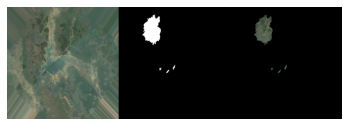

i= 65 loss= 0.07260362803936005 val_loss= 0.4232722009931292 mean_iou= 0.8655345 val_mean_iou= 0.48906988
244.23148


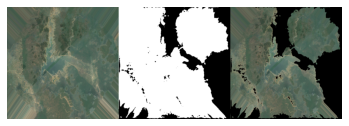

i= 66 loss= 0.15593134835362435 val_loss= 0.11177642217704228 mean_iou= 0.6659757 val_mean_iou= 0.82588285
249.496


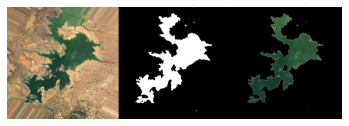

i= 67 loss= 0.08691619634628296 val_loss= 0.05087176550711904 mean_iou= 0.7774811 val_mean_iou= 0.9010987
254.9841


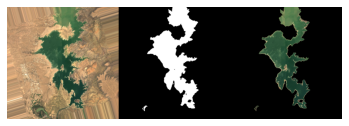

i= 68 loss= 0.04521986525505781 val_loss= 0.04429815496717181 mean_iou= 0.8994878 val_mean_iou= 0.90150833
254.93039


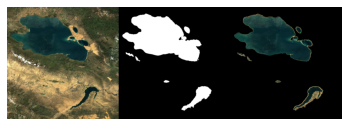

i= 69 loss= 0.12720585763454437 val_loss= 0.06570928543806076 mean_iou= 0.76776516 val_mean_iou= 0.8742854
139.4552


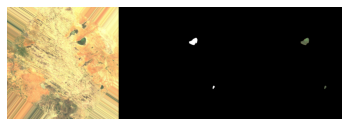

i= 70 loss= 0.06375356316566468 val_loss= 0.04521735491497176 mean_iou= 0.849604 val_mean_iou= 0.9102913
254.99994


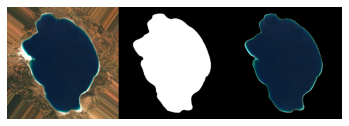

i= 71 loss= 0.05627979375422001 val_loss= 0.0508618274969714 mean_iou= 0.85954684 val_mean_iou= 0.8905406
254.99957


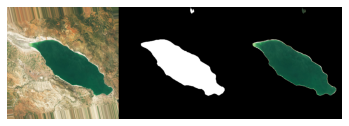

i= 72 loss= 0.05492849163711071 val_loss= 0.04011149864111628 mean_iou= 0.8976008 val_mean_iou= 0.91268295
241.90997


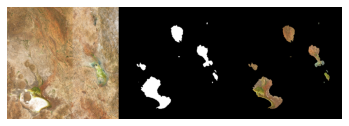

i= 73 loss= 0.04290953762829304 val_loss= 0.04540082865527698 mean_iou= 0.90426826 val_mean_iou= 0.90429157
255.0


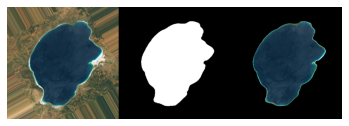

i= 74 loss= 0.177856969833374 val_loss= 0.07956622594169208 mean_iou= 0.77662045 val_mean_iou= 0.8626159
252.15709


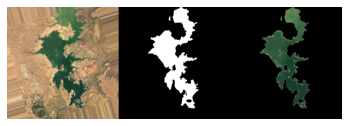

i= 75 loss= 0.06248156800866127 val_loss= 0.056437418929168155 mean_iou= 0.8834136 val_mean_iou= 0.8835858
254.99954


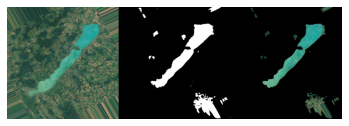

i= 76 loss= 0.06859690248966217 val_loss= 0.03886120021343231 mean_iou= 0.8584256 val_mean_iou= 0.9110742
254.91284


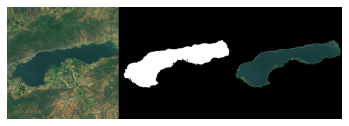

i= 77 loss= 0.040606791339814666 val_loss= 0.03595384556267943 mean_iou= 0.91021377 val_mean_iou= 0.9229771
254.93929


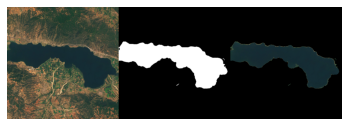

i= 78 loss= 0.0912963330745697 val_loss= 0.1870093292423657 mean_iou= 0.8087673 val_mean_iou= 0.5923915
215.28343


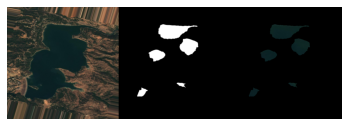

i= 79 loss= 0.10592515021562576 val_loss= 0.04576891767127173 mean_iou= 0.78037524 val_mean_iou= 0.9018765
238.23471


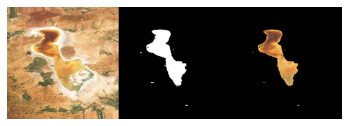

i= 80 loss= 0.0459354504942894 val_loss= 0.04078241490892002 mean_iou= 0.9130109 val_mean_iou= 0.91890925
254.99994


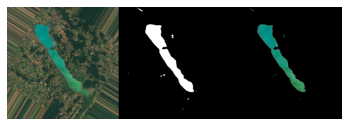

i= 81 loss= 0.04135329928249121 val_loss= 0.03815518372825214 mean_iou= 0.9112336 val_mean_iou= 0.92179877
254.95322


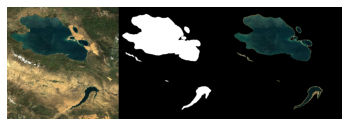

i= 82 loss= 0.04958906657993793 val_loss= 0.03484816662967205 mean_iou= 0.88945806 val_mean_iou= 0.9223512
255.0


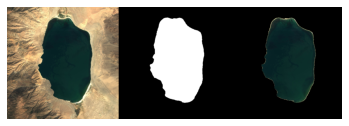

i= 83 loss= 0.25781829841434956 val_loss= 0.05252479176436152 mean_iou= 0.7177707 val_mean_iou= 0.889352
244.6907


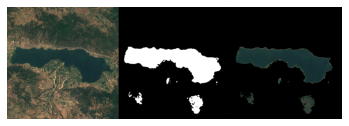

i= 84 loss= 0.05130950100719929 val_loss= 0.040748603375894685 mean_iou= 0.8755506 val_mean_iou= 0.9152966
126.136635


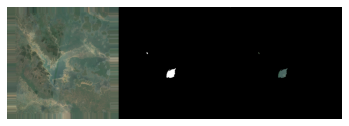

i= 85 loss= 0.04692195057868957 val_loss= 0.03361409130905356 mean_iou= 0.8882025 val_mean_iou= 0.93144566
254.82248


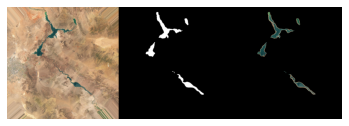

i= 86 loss= 0.05241883061826229 val_loss= 0.03529829664954117 mean_iou= 0.8868898 val_mean_iou= 0.9272731
214.5408


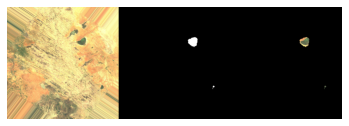

i= 87 loss= 0.04592830166220665 val_loss= 0.03675403765269688 mean_iou= 0.89684343 val_mean_iou= 0.9253853
254.99998


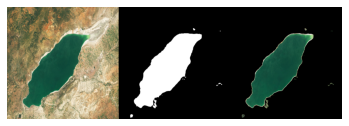

i= 88 loss= 0.07894047498703002 val_loss= 0.04173176682421139 mean_iou= 0.8426754 val_mean_iou= 0.91910696
253.93837


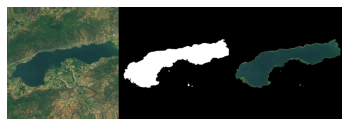

i= 89 loss= 0.04413890168070793 val_loss= 0.03559028117784432 mean_iou= 0.88788813 val_mean_iou= 0.921346
254.77551


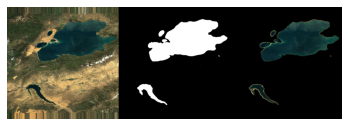

i= 90 loss= 0.08539513312280178 val_loss= 0.06233597600034305 mean_iou= 0.83785075 val_mean_iou= 0.8658905
254.97954


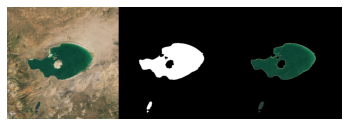

i= 91 loss= 0.05434934198856354 val_loss= 0.05914809448378427 mean_iou= 0.8899027 val_mean_iou= 0.8859649
251.83633


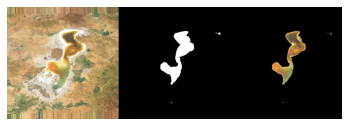

i= 92 loss= 0.04708912819623947 val_loss= 0.038121846105371206 mean_iou= 0.90148175 val_mean_iou= 0.91134405
255.0


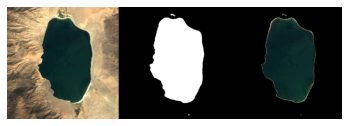

i= 93 loss= 0.040408304147422316 val_loss= 0.23467436007090978 mean_iou= 0.9030229 val_mean_iou= 0.70436704
255.0


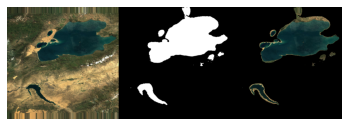

i= 94 loss= 0.1331081360578537 val_loss= 0.044532345341784615 mean_iou= 0.75871193 val_mean_iou= 0.91201085
253.87248


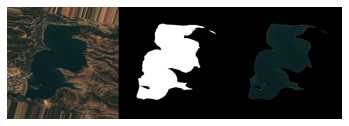

i= 95 loss= 0.0507989838719368 val_loss= 0.04070921242237091 mean_iou= 0.8924858 val_mean_iou= 0.9136201
177.47571


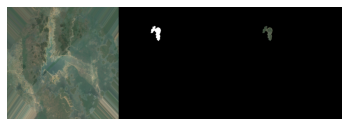

i= 96 loss= 0.034899181500077245 val_loss= 0.03722775860556534 mean_iou= 0.9103142 val_mean_iou= 0.9223045
254.99954


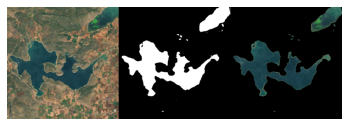

i= 97 loss= 0.037522419542074206 val_loss= 0.030975298157760074 mean_iou= 0.9055213 val_mean_iou= 0.9313241
255.0


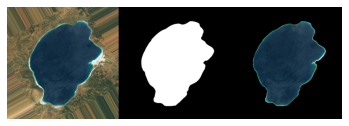

i= 98 loss= 0.03551238738000393 val_loss= 0.029838361644319127 mean_iou= 0.9261813 val_mean_iou= 0.9306484
255.0


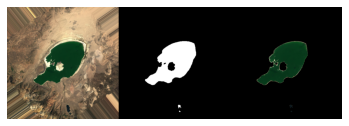

i= 99 loss= 0.06457836981862783 val_loss= 0.06291250990969795 mean_iou= 0.8817482 val_mean_iou= 0.86532444
254.99872


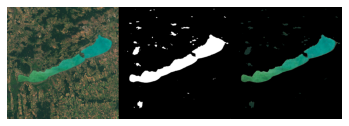

i= 100 loss= 0.03910842817276716 val_loss= 0.03214967091168676 mean_iou= 0.9164934 val_mean_iou= 0.9216355
254.99767


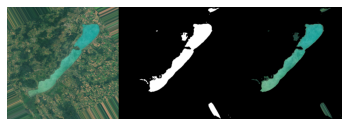

In [46]:
historyS2 = model.fit_generator(train_generatorS2, 
                    epochs = 100, steps_per_epoch = train_stepsS2,
                    validation_data = test_generatorS2, validation_steps = test_stepsS2,
                    callbacks = build_callbacksS2(), verbose = 0,
                    use_multiprocessing=True)

#### NWPU imagery

Define the test and train steps like in Part 4 and run the model training

In [49]:
all_files = os.listdir('nwpu_images/data')
shuffle(all_files)

split = int(prop_train * len(all_files))

#split into training and testing
train_filesNWPU = all_files[0:split]
test_filesNWPU  = all_files[split:]

train_stepsNWPU = len(train_filesNWPU) //batch_size
test_stepsNWPU = len(test_filesNWPU) //batch_size

print(train_stepsNWPU)
print(test_stepsNWPU)

train_generatorNWPU = image_batch_generatorNWPU(train_filesNWPU, batch_size = batch_size)
test_generatorNWPU  = image_batch_generatorNWPU(test_filesNWPU, batch_size = batch_size)

42
28


i= 1 loss= 0.37301050020115717 val_loss= 0.2822285619165216 mean_iou= 0.3461516 val_mean_iou= 0.6342388
158.80992


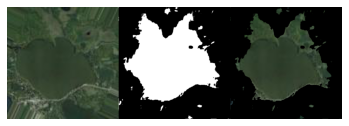

i= 2 loss= 0.24150208969201362 val_loss= 0.2190017325005361 mean_iou= 0.61470675 val_mean_iou= 0.6441484
244.47536


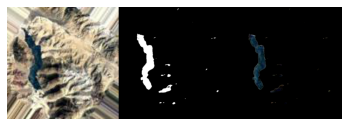

i= 3 loss= 0.21639111407455944 val_loss= 0.311054240912199 mean_iou= 0.647537 val_mean_iou= 0.48894516
250.75717


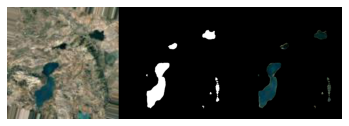

i= 4 loss= 0.2090242441211428 val_loss= 0.21830496511289052 mean_iou= 0.6667661 val_mean_iou= 0.7222929
253.60855


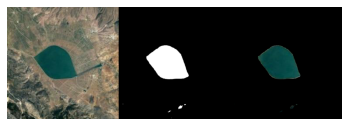

i= 5 loss= 0.17540636303878965 val_loss= 0.16839056488658702 mean_iou= 0.7303264 val_mean_iou= 0.6982547
251.40591


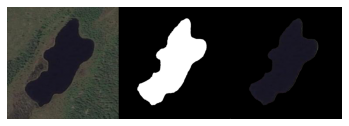

i= 6 loss= 0.15981424014483178 val_loss= 0.12829407251306943 mean_iou= 0.7281484 val_mean_iou= 0.7914924
252.22229


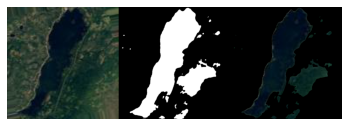

i= 7 loss= 0.18478500772090184 val_loss= 0.1507393028587103 mean_iou= 0.73949826 val_mean_iou= 0.74139154
253.81828


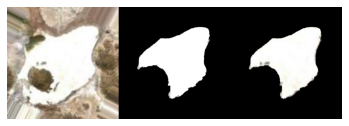

i= 8 loss= 0.15129562272202401 val_loss= 0.13171890351389134 mean_iou= 0.74559355 val_mean_iou= 0.7824422
254.99942


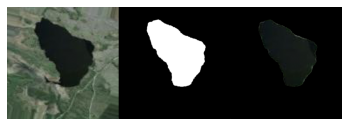

i= 9 loss= 0.15501118486835844 val_loss= 0.1423906298088176 mean_iou= 0.7484167 val_mean_iou= 0.77452505
254.99966


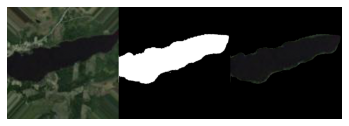

i= 10 loss= 0.19010757637165843 val_loss= 0.1337841594857829 mean_iou= 0.73983854 val_mean_iou= 0.7823299
254.99716


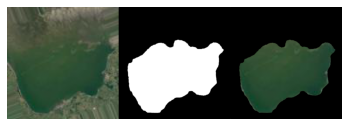

i= 11 loss= 0.1367467258657728 val_loss= 0.11261328695608037 mean_iou= 0.7647884 val_mean_iou= 0.8093917
247.26947


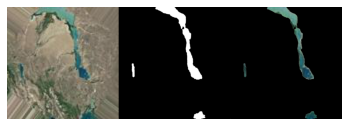

i= 12 loss= 0.15447005931110608 val_loss= 0.11683506372251681 mean_iou= 0.7561553 val_mean_iou= 0.80623466
254.99934


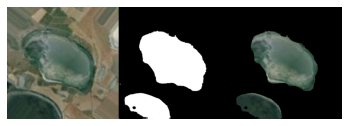

i= 13 loss= 0.13875731231556052 val_loss= 0.11781610654933113 mean_iou= 0.78315765 val_mean_iou= 0.8036095
255.0


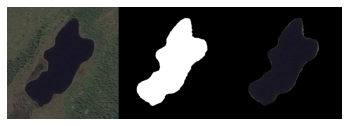

i= 14 loss= 0.13921033697468893 val_loss= 0.11212565111262458 mean_iou= 0.7720987 val_mean_iou= 0.80875975
254.99681


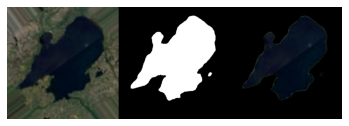

i= 15 loss= 0.11370468059820789 val_loss= 0.11812205386481114 mean_iou= 0.80430156 val_mean_iou= 0.81660396
255.0


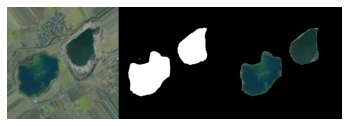

i= 16 loss= 0.11219292275962375 val_loss= 0.13532196557415382 mean_iou= 0.81184334 val_mean_iou= 0.7726659
252.34982


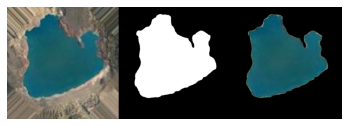

i= 17 loss= 0.13309020478101002 val_loss= 0.11560636426189116 mean_iou= 0.7665639 val_mean_iou= 0.80535126
248.86826


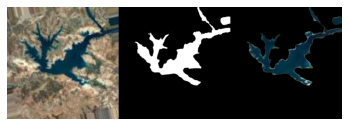

i= 18 loss= 0.12017440077449594 val_loss= 0.11056291511548418 mean_iou= 0.7966688 val_mean_iou= 0.8207599
254.99457


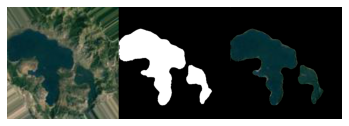

i= 19 loss= 0.10554818126062553 val_loss= 0.10044651611575059 mean_iou= 0.802029 val_mean_iou= 0.828821
254.8962


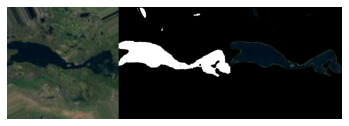

i= 20 loss= 0.11047605008241676 val_loss= 0.23098756106836454 mean_iou= 0.7980834 val_mean_iou= 0.66100484
254.3538


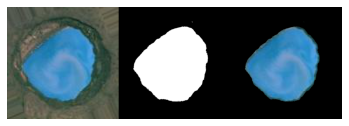

i= 21 loss= 0.10350118240430242 val_loss= 0.11464618412511689 mean_iou= 0.8058568 val_mean_iou= 0.7941584
254.91397


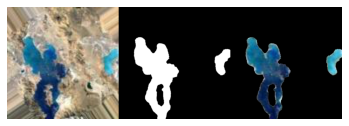

i= 22 loss= 0.13385096014965148 val_loss= 0.11005703040531703 mean_iou= 0.79526454 val_mean_iou= 0.81641376
254.99872


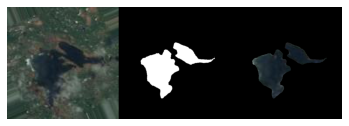

i= 23 loss= 0.10574781779377233 val_loss= 0.19465794094971248 mean_iou= 0.81919795 val_mean_iou= 0.68951
248.53838


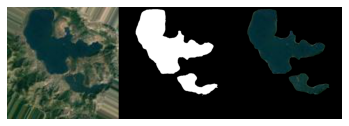

i= 24 loss= 0.1267540641129017 val_loss= 0.08852315960185868 mean_iou= 0.78096896 val_mean_iou= 0.84881335
254.9353


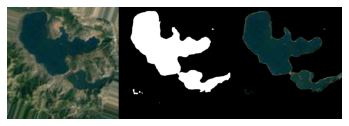

i= 25 loss= 0.09797943764854045 val_loss= 0.10419422215116876 mean_iou= 0.82085437 val_mean_iou= 0.81817997
254.58263


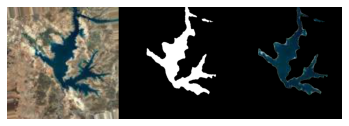

i= 26 loss= 0.09960001937690235 val_loss= 0.09185865454907928 mean_iou= 0.8172519 val_mean_iou= 0.84506834
255.0


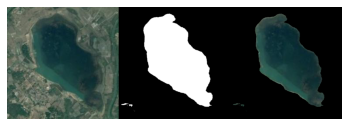

i= 27 loss= 0.11542549401166893 val_loss= 0.09565243657146182 mean_iou= 0.81182414 val_mean_iou= 0.84100914
255.0


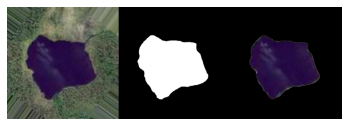

i= 28 loss= 0.08758798685102236 val_loss= 0.6092298626899719 mean_iou= 0.83963656 val_mean_iou= 0.5543666
243.75107


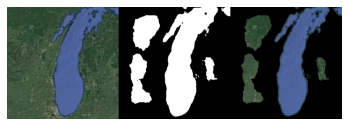

i= 29 loss= 0.10927819682373888 val_loss= 0.1977581067809037 mean_iou= 0.8356798 val_mean_iou= 0.7491511
254.82047


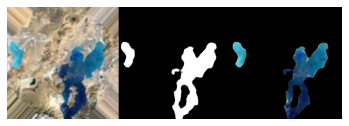

In [ ]:
historyNWPU = model.fit_generator(train_generatorNWPU, 
                    epochs = 100, steps_per_epoch = train_stepsNWPU,
                    validation_data = test_generatorNWPU, validation_steps = test_stepsNWPU,
                    callbacks = build_callbacksNWPU(), verbose = 0,
                    use_multiprocessing=True)

In [ ]:
historyS2.model.save_weights("historyS2.model")
historyNWPU.model.save_weights("historyNWPU.model")

#### Test NWPU model on S2 imagery

First, set up a new generator function to generate batches of S2 augmented imagery and associated labels. Then, define a function that will use the model (trained on NWPU imagery) to estimate the binary semantic segmentation mask for 100 images. Finally, we'll look at the mean IOU score, and their distribution

In [ ]:
# rerun the generator function to start with a fresh set from the beginning of the list
test_generatorS2  = image_batch_generatorS2(test_filesS2, batch_size = batch_size)

# we need to change the IOU function a little because the inputs are slightly different shapes than used in the training
def mean_iou(y_true, y_pred):
    yt0 = y_true.squeeze()
    yp0 = tf.keras.backend.cast(y_pred.squeeze() > 0.5, 'float32')
    inter = tf.math.count_nonzero(tf.logical_and(tf.equal(yt0, 1), tf.equal(yp0, 1)))
    union = tf.math.count_nonzero(tf.add(yt0, yp0))
    iou = tf.where(tf.equal(union, 0), 1., tf.cast(inter/union, 'float32'))
    return iou

# a function for getting an estimated water mask from an input image, and IOU score evaluated against the real mask
def get_pred(x, y):
    #predict the mask 
    pred = model.predict(np.expand_dims(x, 0))
    
    #mask post-processing 
    msk  = pred.squeeze()
    # binarize
    msk[msk >= 0.5] = 1 
    msk[msk < 0.5] = 0
    # return the prediction and the IOU score of the prediction
    return msk, mean_iou(y, msk)

Let's see how this will work:

In [ ]:
#get a batch of S2 imagery and labels
x, y = next(test_generatorS2) 
#get the predicted mask and iou score for the first
ypred, iou = get_pred(x[0], y[0]) 

#make a plot side-by-side of label ...
plt.subplot(121)
plt.imshow(x[0])
plt.imshow(y[0].squeeze(), alpha=0.5, cmap='gray')
plt.axis('off')

# ... and estimated label
plt.subplot(122)
plt.imshow(x[0])
plt.imshow(ypred.squeeze(), alpha=0.5, cmap='gray')
plt.title(str(iou.numpy())[:4])
plt.axis('off')

In [ ]:
IOU = [] #initialize list
counter = 0 #initialize counter
while counter < 100: # compare 100 images
    x, y = next(test_generatorS2)
    ypred, iou = get_pred(x[0], y[0])
    IOU.append(iou) #update list

    if counter % 5 == 0: #print every 5th comparison
        plt.figure(figsize=(4,6))
        plt.subplot(121)
        plt.imshow(x[0])
        plt.imshow(y[0].squeeze(), alpha=0.5, cmap='gray')
        plt.axis('off')

        plt.subplot(122)
        plt.imshow(x[0])
        plt.imshow(ypred.squeeze(), alpha=0.5, cmap='gray')
        plt.title(str(iou.numpy())[:4])
        plt.axis('off')
        print(counter)  
        
    counter += 1 #update counter

Print the mean IOU score to screen and make a boxplot of the distribution of IOU scores

In [ ]:
print(np.mean(IOU))

In [ ]:
%matplotlib inline
fliers = dict(markerfacecolor='g', marker='p')
plt.figure(figsize=(8,4))
plt.boxplot(IOU, flierprops=fliers, vert=False, whis=0.75)
plt.xlabel('IOU scores')

This baseline comparison isn't brilliant but it is pretty good considering it hasn't yet been optimized AND it was built on a completely different set of images (NWPU). In deep learning, this concept of training a model on one set of imagery and applying to another, is called transfer learning and is very common in modern machine learning workflows.

We'll see in the final part many strategies for improving this accuracy. This distribution of IOU scores is the baseline against which we will improve upon

<table style="font-size: 1em; padding: 0; margin: 0;">

<h1 style="width: 100%; text-align: left; padding: 0px 25px;"><small style="color: #182AEB;">
    </small><br/>Going further: <br/> train models with your own data</h1>
<br/>
<p style="border-left: 15px solid #182AEB; text-align:justify; padding: 0 10px;">
If you developed your own imagery in Part 2, you should be able to adapt the workflow presented here to developing training and testing sets (augmented or not). You could choose to build separate UNet models for each dataset, or merge datasets together to build one 'master' UNet model. Most deep learning studies report that model performance scale with data set size.
</p>
<p style="border-left: 15px solid #6019D6; padding: 0 10px; text-align:justify;">
    <strong style="color: #6019D6;">Tip.</strong> 
Many deep learning studies report that model performance scale with model size, so you could add filters to the unet model atchitecture presented in this part
</p>
        </tr>
        </table>